In [18]:
import os

def run_fast_scandir(dir, ext):    
    subfolders, datafiles = [], []

    for f in os.scandir(dir):
        if f.is_dir():
            subfolders.append(f.path)
        if f.is_file():
            if os.path.splitext(f.name)[1].lower() in ext:
                datafiles.append(f.path)

    for dir in list(subfolders):
        sf, f = run_fast_scandir(dir, ext)
        subfolders.extend(sf)
        datafiles.extend(f)
    return subfolders, datafiles

In [19]:
def pick_channels(ch_labels, desired_channels):
    ch_idx = []    
    for dc in desired_channels:
        for i, c in enumerate(ch_labels):
            if dc in c:
                ch_idx.append(i)
    return ch_idx


# **Pre-processing pipeline toggling variables**



In [ ]:
CAR_REF = True
RUN_ICA = False
APPLY_ICA = False
X_DAWN = False

# **Importing signal**

## Signal info

------
Data paths: 

C:/Users/VascoRocha(1161216)/Desktop/Rocha/EEG Data/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/EEG Data/

In [73]:
import mne
import numpy as np

file = "MiguelRocha_session_01_train.edf"
raw_eeg = mne.io.read_raw_edf(f"C:/Users/VascoRocha(1161216)/Desktop/Rocha/EEG Data/{file}", 
                              preload=True)

print("\n", raw_eeg.info.keys())
print("\n", raw_eeg.info)

ch = raw_eeg.info["ch_names"] # Channel labels
fs = raw_eeg.info["sfreq"]

print("\nChannel labels: ", ch)

Extracting EDF parameters from C:\Users\VascoRocha(1161216)\Desktop\Rocha\EEG Data\MiguelRocha_session_01_train.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 1212671  =      0.000 ...   592.125 secs...

 dict_keys(['acq_pars', 'acq_stim', 'ctf_head_t', 'description', 'dev_ctf_t', 'dig', 'experimenter', 'utc_offset', 'device_info', 'file_id', 'highpass', 'hpi_subsystem', 'kit_system_id', 'helium_info', 'line_freq', 'lowpass', 'meas_date', 'meas_id', 'proj_id', 'proj_name', 'subject_info', 'xplotter_layout', 'gantry_angle', 'bads', 'chs', 'comps', 'events', 'hpi_meas', 'hpi_results', 'projs', 'proc_history', 'custom_ref_applied', 'sfreq', 'dev_head_t', 'ch_names', 'nchan'])

 <Info | 8 non-empty values
 bads: []
 ch_names: EEG T7'', EEG TP7'', EEG P7'', EEG PO7'', EEG CP5'', EEG P5'', ...
 chs: 36 EEG
 custom_ref_applied: False
 highpass: 0.1 Hz
 lowpass: 538.0 Hz
 meas_date: 2024-04-26 18:12:46 UTC
 nchan: 36
 projs: []
 sfreq: 2

# **Analysing signal quality and pre-processing data accordingly**

## Checking if the recorded signal is an EEG (1/f shape)

### Designing the band pass filter

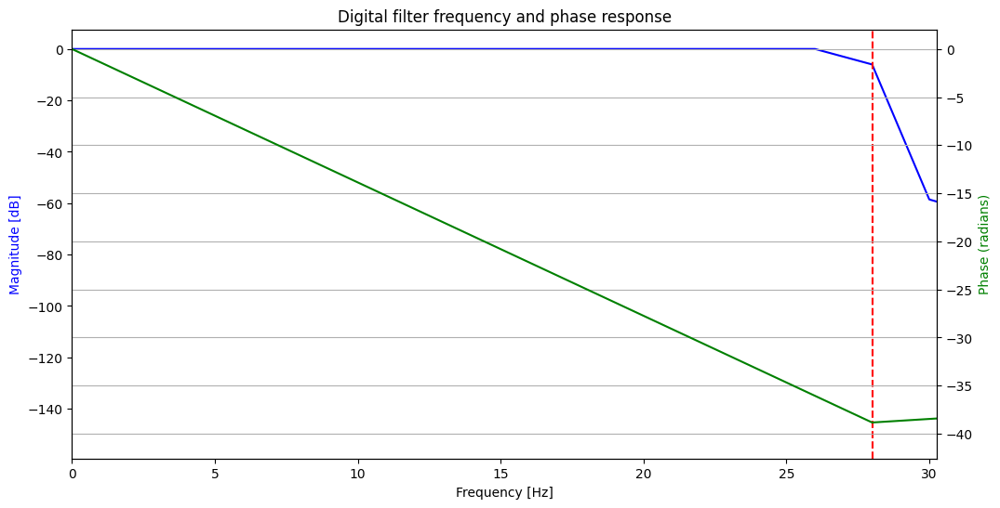

In [74]:
import scipy
from scipy.signal import filtfilt, firwin, freqz

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# Designing a low-pass FIR filter at 28 Hz
nyquist = fs/2
lowcut = 28
numtaps = 5001 # Order
filt = firwin(numtaps, 
              lowcut/nyquist, 
              pass_zero=True)  
'''
pass_zero -> If True, the gain at frequency 0 (DC) is 1, creating a low-pass filter.
              If False, the DC gain is 0, creating a high-pass filter.
'''

# Ploting the frequency response of the filter
w, h = freqz(filt) # The frequency response is returned as a tuple (w, h), where w is the array of frequencies and h is the array of complex coeficients (w: rad/samples)

fig, ax1 = plt.subplots(figsize = (12,6))

ax1.set_title('Digital filter frequency and phase response')
ax1.plot(w*fs/(2*np.pi), 20 * np.log10(abs(h)), 'b')
ax1.set_ylabel('Magnitude [dB]', color='b')
ax1.set_xlabel('Frequency [Hz]')
ax1.set_xticks(np.arange(0,lowcut * 4/3.7, 5))
ax1.axvline(x = lowcut, color = 'r', linestyle = '--')

ax2 = ax1.twinx()
ax2.plot(w*fs/(2*np.pi), np.unwrap(np.angle(h)), 'g')
ax2.set_ylabel('Phase (radians)', color='g')
ax2.grid(True)
ax2.axis('tight')
ax2.set_xlim(0, lowcut * 4/3.7)

plt.show()

# Applying the filter to the signal using filtfilt
# EEG shape: (channels, samples)
eeg_ch_idx = mne.pick_channels(ch, 
                               include = [], 
                               exclude = ['dc01+', 'dc02+', 'MKR+'])

filt_eeg = filtfilt(filt, 
                    1, 
                    raw_eeg.get_data(picks = eeg_ch_idx), 
                    axis = 1)


### Apllying the FFT on the EEG signal

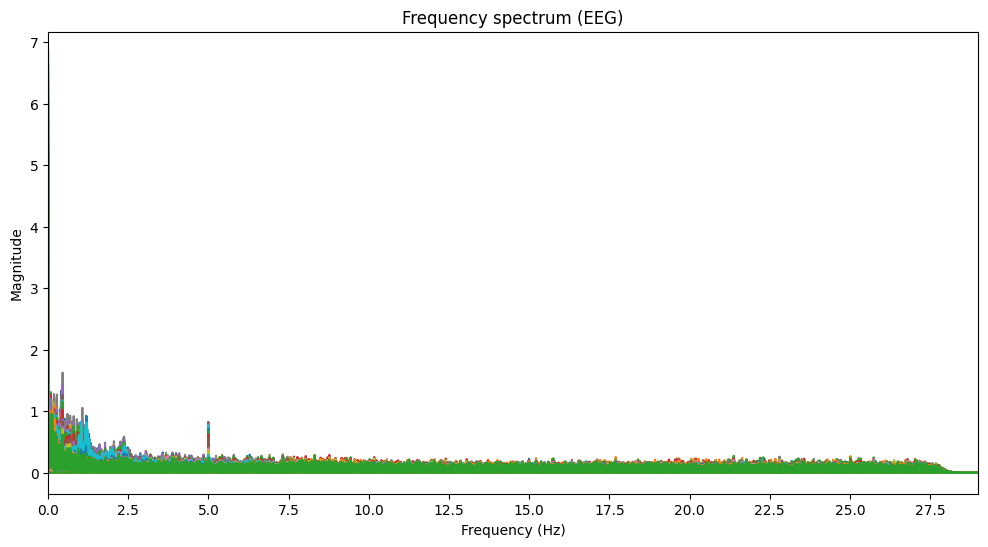

In [75]:
X = np.fft.fft(filt_eeg, axis = 1)

# Compute the frequency vector
freqs = np.fft.fftfreq(np.size(X,1), 1/fs)

# Plot the frequency spectrum
figure(figsize = (12,6))
plt.plot(freqs, np.abs(X.T))
plt.title("Frequency spectrum (EEG)")
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.xlim(0, lowcut + 1)
plt.xticks(np.arange(0, lowcut + 1, 2.5)) 
plt.show()

## Analysing electrode smearing/bridging

Creating RawArray with float64 data, n_channels=33, n_times=1212672
    Range : 0 ... 1212671 =      0.000 ...   592.125 secs
Ready.


Local minimum 1.795145533734187e-11 found


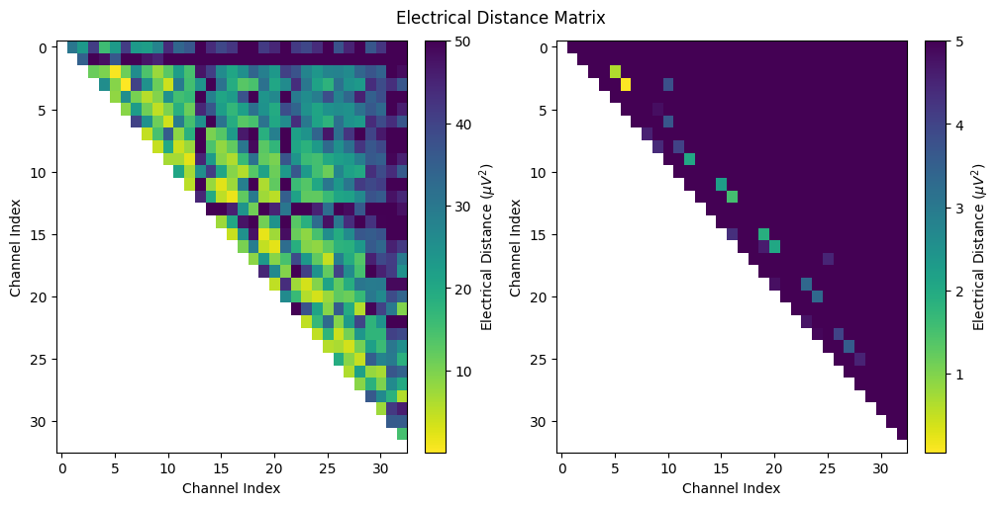

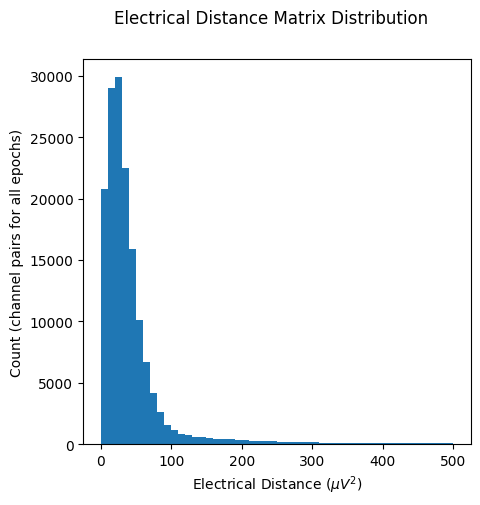

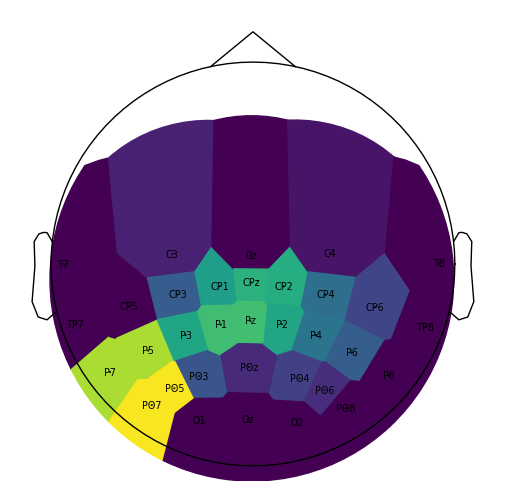

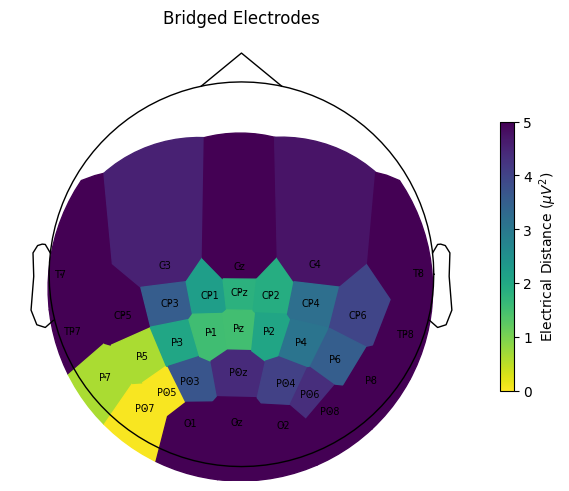

In [76]:
cust_ch = [ch[c].split("EEG ")[1] for c in eeg_ch_idx if ("EEG " in ch[c])]
clean_ch = [c.split("''")[0] for c in cust_ch]

for c in range(len(clean_ch)):
    if clean_ch[c] == 'FP1':
        clean_ch[c] = 'Fp1'
    elif (clean_ch[c] == 'FP2'):
        clean_ch[c] = 'Fp2'

ch_types = ['eeg'] * len(clean_ch)

new_info = mne.create_info(ch_names = clean_ch, 
                           sfreq = fs, 
                           ch_types = ch_types)

eeg_smearing = mne.io.RawArray(filt_eeg, new_info)
eeg_smearing.set_montage('standard_1005')

## Examine an Electrical Distance Matrix

ed_data = mne.preprocessing.compute_bridged_electrodes(eeg_smearing)
bridged_idx, ed_matrix = ed_data

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), layout="constrained")
fig.suptitle("Electrical Distance Matrix")

# take median across epochs, only use upper triangular, lower is NaNs
ed_plot = np.zeros(ed_matrix.shape[1:]) * np.nan
triu_idx = np.triu_indices(ed_plot.shape[0], 1)
for idx0, idx1 in np.array(triu_idx).T:
    ed_plot[idx0, idx1] = np.nanmedian(ed_matrix[:, idx0, idx1])

# plot full distribution color range
im1 = ax1.imshow(ed_plot, aspect="auto", vmax=50, cmap = "viridis_r")
cax1 = fig.colorbar(im1, ax=ax1)
cax1.set_label(r"Electrical Distance ($\mu$$V^2$)")

# plot zoomed in colors
im2 = ax2.imshow(ed_plot, aspect="auto", vmax=5, cmap = "viridis_r")
cax2 = fig.colorbar(im2, ax=ax2)
cax2.set_label(r"Electrical Distance ($\mu$$V^2$)")
for ax in (ax1, ax2):
    ax.set_xlabel("Channel Index")
    ax.set_ylabel("Channel Index")

## Examine the Distribution of Electrical Distances

fig, ax = plt.subplots(figsize=(5, 5))
fig.suptitle("Electrical Distance Matrix Distribution")
ax.hist(ed_matrix[~np.isnan(ed_matrix)], bins=np.linspace(0, 500, 51))
ax.set_xlabel(r"Electrical Distance ($\mu$$V^2$)")
ax.set_ylabel("Count (channel pairs for all epochs)")

## Plot Electrical Distances on a Topomap
mne.viz.plot_bridged_electrodes(
    eeg_smearing.info,
    bridged_idx,
    ed_matrix, 
    title = "Bridged Electrodes",
    topomap_args=dict(vlim=(None, 5),
                      cmap = "viridis_r", 
                      size = 10,
                      sphere=(0.0011, 0.015, 0.12, 0.2)),
)

## Interpolating bridged channels based on the amount of connections

In [77]:
bridged_idx = ed_data[0]

num_smeared_electrodes = 0
for i in bridged_idx:
     num_smeared_electrodes += len(i)

print("Number of connections: ", num_smeared_electrodes)

if(len(bridged_idx) > 0 and num_smeared_electrodes <= 8):
    filt_eeg = mne.preprocessing.interpolate_bridged_electrodes(
        eeg_smearing.copy(), 
        bridged_idx=bridged_idx
    )
    
    filt_eeg = filt_eeg.get_data()


Number of connections:  0


## Bad channel interpolation (O1)

In [78]:

eeg_smearing.info["bads"] = [clean_ch[13]] 
eeg_smearing.interpolate_bads()


Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 32 sensor positions
Interpolating 1 sensors


Measurement date,Unknown
Experimenter,Unknown
Participant,Unknown
Digitized points,36 points
Good channels,33 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,2048.00 Hz
Highpass,0.00 Hz
Lowpass,1024.00 Hz


## Re-referencing (Common Average)

CAR reference can be useful but if noisy channels are contained in the averaging, this noise is propagated to the entire scalp. This can be seen in Sara EEG in the SNR and PSD graphs. The SSVEP is propagated to the rest of the signal, thus increasing the average SNR, mainly at the SSVEP and their harmonics (10 and 15 Hz). Furthermore, spread activity like the P300 can will appear reduced.

In [79]:
car = np.zeros(np.shape(filt_eeg))
for dt in range(np.size(filt_eeg, 1)):
    ch_sum = []
    for c in range(np.size(filt_eeg, 0)):
        ch_sum.append(filt_eeg[c,dt])
    car[:,dt] = filt_eeg[:,dt] - np.mean(ch_sum)

filt_eeg = car

In [80]:
eeg_smearing = mne.io.RawArray(filt_eeg, new_info)
eeg_smearing.set_montage('standard_1005')

Creating RawArray with float64 data, n_channels=33, n_times=1212672
    Range : 0 ... 1212671 =      0.000 ...   592.125 secs
Ready.


Measurement date,Unknown
Experimenter,Unknown
Participant,Unknown
Digitized points,36 points
Good channels,33 EEG
Bad channels,None
EOG channels,Not available
ECG channels,Not available
Sampling frequency,2048.00 Hz
Highpass,0.00 Hz
Lowpass,1024.00 Hz


## Isolating the LDR channel

In [81]:
def plot_isolated_signal(time, signal, th, title):
    figure(figsize = (400,20))
    plt.plot(time, signal, linewidth = 2);
    plt.title(title, fontsize = 100, fontweight = 'bold')
    plt.xlabel('Time (min)', fontsize = 85, fontweight = 'bold')
    plt.ylabel('Voltage (V)', fontsize = 85, fontweight = 'bold')
    plt.xticks(np.arange(0, np.max(time), 0.05), fontsize = 30)
    plt.yticks(np.arange(np.min(signal), np.max(signal), 0.1), fontsize = 30)
    plt.xlim([0,max(time)])
    plt.axhline(y = th, color = 'k', linestyle = '--', linewidth = 2)
    plt.grid()

In [82]:
ldr_ch_idx = mne.pick_channels(ch, include = ['dc01+'])
ldr_ch = raw_eeg.get_data(picks = ch[ldr_ch_idx[0]])
if (np.mean(ldr_ch) < 0): # If the polarity was inverted
    print("Inverting signal...")
    ldr_ch = ldr_ch * -1
''' 
The bright square (more light) will decrease the resistance of the LDR, thus producing more voltage
aproximating 2.4V if the polarity of the component was right or -2.4V if the polarity was inverted

The dark square will increase the resistance to the MOhm range and cause the signal to be almost 0.
This is because all the voltage will be sucked by the first component (LDR) of the voltage divider.
'''

time = np.arange(0, np.size(ldr_ch,1)/fs, 1/fs) # Time vector of the acquisition in s

if(np.mean(ldr_ch) >= 0.65):
    th = 1.2 # y value threshold to segment signal
else:
    th = 0.8

plot_isolated_signal(time/60, ldr_ch[0][:], th, "LDR channel") # time/60 = timevector in minutes
plt.show()

### Checking different filter effects on the LDR channel to see if the instances each images appear are maintained

In [83]:
def moving_aver(ldr_ch_snip, window_size):

    b = np.ones(window_size) / window_size

    # Apply filtering with appropriate padding mode
    filtered_data = filtfilt(b, 
                             1, 
                             ldr_ch_snip, 
                             padlen=window_size - 1)

    return filtered_data

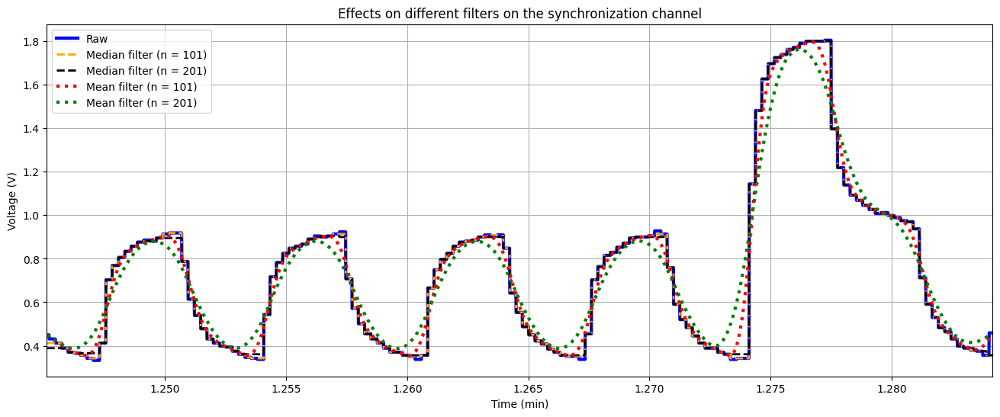

In [84]:
ldr_ch_snip = ldr_ch[0][153000:157800]
time_snip = time[153000:157800]/60

figure(figsize = (16,6))
plt.plot(time_snip, ldr_ch_snip, "b", linewidth = 3, label = "Raw");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 101), "orange", linestyle = "--",linewidth = 2, label = "Median filter (n = 101)");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 201), "k--", linewidth = 2, label = "Median filter (n = 201)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 101), "r:", linewidth = 3, label = "Mean filter (n = 101)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 201), "g:", linewidth = 3, label = "Mean filter (n = 201)");


plt.title("Effects on different filters on the synchronization channel")
plt.xlabel("Time (min)")
plt.ylabel("Voltage (V)")
plt.xlim([np.min(time_snip), np.max(time_snip)])
plt.legend()
plt.grid()

plt.show()

## Filtering the LDR channel based on the best approach to smooth the signal without altering the edges' instances (Median filter)

In [85]:
n_filt = 201

print("Average Voltage (LDR): ", np.mean(ldr_ch))

filt_ldr_ch = scipy.signal.medfilt(ldr_ch[:][0], n_filt) 
# A 201 points median filter seems to be enough to smooth the signal without causing phase shifts
# The filter applies a zero pad automatically at the edges

plot_isolated_signal(time/60, filt_ldr_ch, th, "Filtered LDR channel")
plt.show()

Average Voltage (LDR):  0.7292844354642669


# **Segmenting the EEG**

## Detecting the edges on the LDR channel

In [86]:
def condition_segmentation(ldr, th):
    
    last_low = True
    last_high = False
    
    rising_edges = []
    falling_edges = []

    for index, val in enumerate(ldr):

        if val >= th: # Possible rising edge
            if last_low: # Found rising edge
                rising_edges.append(index) 
            
            last_low = False
            last_high = True
        
        elif val <= th: # Possible falling edge
            if last_high:
                falling_edges.append(index)

            last_low = True
            last_high = False

    return rising_edges, falling_edges

In [87]:
d_th = th - 0.1 # Divinding the LDR channel in the target and non target range
t_th = th

if(np.mean(ldr_ch) >= 0.65):
    nt_th = 0.675
    ssvep_th = 0.23
else:
    nt_th = 0.4
    ssvep_th = 0.11

# Target trials
target_range = [val if val >= d_th else d_th for val in filt_ldr_ch]
t_rising_edges, t_falling_edges = condition_segmentation(target_range, t_th)

# Non target trials
nontarget_range = [val if val <= d_th else d_th for val in filt_ldr_ch]
nt_rising_edges, nt_falling_edges = condition_segmentation(nontarget_range, nt_th)

if(len(nt_rising_edges) > len(nt_falling_edges)):
    nt_rising_edges.pop(-1)

# SSVEP trial blocks
trialBlock_range = [val if val <= ssvep_th else d_th for val in filt_ldr_ch]
ssvep_rising_edges, ssvep_falling_edges = condition_segmentation(trialBlock_range, ssvep_th - 0.03)

ssvep_rising_edges.pop(0), ssvep_falling_edges.pop(0)# EMG edge

NUM_BLOCKS = 10

if (len(ssvep_rising_edges) > NUM_BLOCKS):
    ssvep_rising_edges.pop(-1) # After finishing the protocol there is one non-relevant rising edge


'''
plot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")
for idx, start_sample in enumerate(t_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = t_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()


plot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")
for idx, start_sample in enumerate(nt_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()
'''

'\nplot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")\nfor idx, start_sample in enumerate(t_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = t_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n\n\nplot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")\nfor idx, start_sample in enumerate(nt_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n'

## Segmenting the EEG based on the LDR channel edges

In [88]:
preStim_offset = -0.2 # ms
posStim_offset = 0.6 

# Targets
target_eeg_blocks = []
t_events = []

for idx, start_sample in enumerate(t_rising_edges):

    if (idx == 0): # EMG time
        emg = filt_eeg[:,start_sample:t_falling_edges[idx]]
        emg_begin_sample = start_sample
        
    else: ## EEG time
        start = np.argmin(np.abs(time - start_sample/fs - preStim_offset))
        stop  = np.argmin(np.abs(time - start_sample/fs - posStim_offset)) 
        target_eeg_blocks.append(filt_eeg[:,start:stop+1])

        t_events.append([start_sample, 0 , 1])

# Non-Targets
nontarget_eeg_blocks = []
nt_events = []

for idx, start_sample in enumerate(nt_rising_edges):
    time_range1 = (nt_falling_edges[idx] - nt_rising_edges[idx])/fs

    # Non Target upper range
    if(time_range1 >= 0.17 and time_range1 <= 0.23):
        start1 = np.argmin(np.abs(time - start_sample/fs - preStim_offset))
        stop1  = np.argmin(np.abs(time - start_sample/fs - posStim_offset)) 
        nontarget_eeg_blocks.append(filt_eeg[:,start1:stop1+1])

        nt_events.append([start_sample, 0, 0])

    # Non Target lower range
    if(idx < len(nt_falling_edges)-1):
        time_range2 = (nt_rising_edges[idx+1] - nt_falling_edges[idx])/fs
        if(time_range2 >= 0.17 and time_range2 <= 0.23):
            start2 = np.argmin(np.abs(time - nt_falling_edges[idx]/fs - preStim_offset))
            stop2  = np.argmin(np.abs(time - nt_falling_edges[idx]/fs - posStim_offset)) 
            nontarget_eeg_blocks.append(filt_eeg[:,start2:stop2+1])

            nt_events.append([np.argmin(np.abs(time - nt_falling_edges[idx]/fs)), 0, 0])

print("Target blocks shape: ", np.shape(target_eeg_blocks))   
print("Non-Target blocks shape: ", np.shape(nontarget_eeg_blocks))   


Target blocks shape:  (240, 33, 1640)
Non-Target blocks shape:  (1704, 33, 1640)


## Frequency tagging and SNR estimation of the SSVEP component on the EEG comprised by the 14 trial blocks
https://mne.tools/dev/auto_tutorials/time-freq/50_ssvep.html

In [89]:
ssvep_events = []
for tb in range(len(ssvep_rising_edges)):
    ssvep_events.append([ssvep_rising_edges[tb], 0 , 0])

tmax = round((ssvep_falling_edges[1] - ssvep_rising_edges[1])/fs,1)

events_id = dict(trialBlocks=0)
ssvep_epochs = mne.Epochs(eeg_smearing, 
                          ssvep_events, 
                          event_id = events_id, 
                          tmin = 0, 
                          tmax = tmax, 
                          baseline=None, 
                          event_repeated = 'error')

Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated


### Calculate power spectral density (PSD)

In [90]:
tmin = 1 # SSVEP response can often take a while to stabilize and the transient phase in the beginning can distort the signal estimate.
fmin = 1
fmax = 26

spectrum = ssvep_epochs.compute_psd(
    "welch",
    n_fft=int(fs * (tmax - tmin)),
    n_overlap=0,
    n_per_seg=None,
    tmin=tmin,
    tmax=tmax,
    fmin=fmin,
    fmax=fmax,
    window="boxcar",
    verbose=False)

psds, freqs = spectrum.get_data(return_freqs=True)

### Calculate signal to noise ratio (SNR)

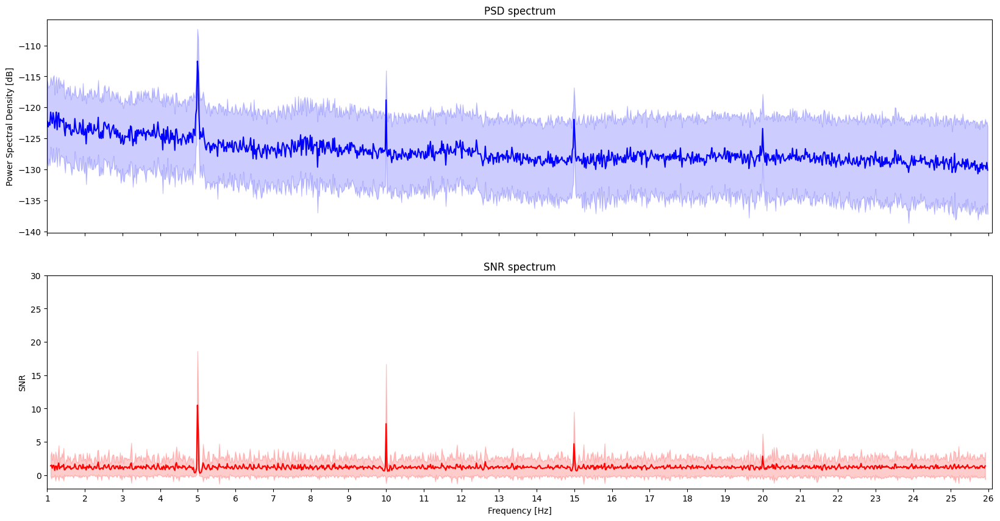

In [91]:
def snr_spectrum(psd, noise_n_neighbor_freqs=1, noise_skip_neighbor_freqs=1):
    """Compute SNR spectrum from PSD spectrum using convolution.

    Parameters
    ----------
    psd : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Data object containing PSD values. Works with arrays as produced by
        MNE's PSD functions or channel/trial subsets.
    noise_n_neighbor_freqs : int
        Number of neighboring frequencies used to compute noise level.
        increment by one to add one frequency bin ON BOTH SIDES
    noise_skip_neighbor_freqs : int
        set this >=1 if you want to exclude the immediately neighboring
        frequency bins in noise level calculation

    Returns
    -------
    snr : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Array containing SNR for all epochs, channels, frequency bins.
        NaN for frequencies on the edges, that do not have enough neighbors on
        one side to calculate SNR.
    """
    # Construct a kernel that calculates the mean of the neighboring
    # frequencies
    averaging_kernel = np.concatenate(
        (
            np.ones(noise_n_neighbor_freqs),
            np.zeros(2 * noise_skip_neighbor_freqs + 1),
            np.ones(noise_n_neighbor_freqs),
        )
    )
    averaging_kernel /= averaging_kernel.sum()

    # Calculate the mean of the neighboring frequencies by convolving with the
    # averaging kernel.
    mean_noise = np.apply_along_axis(
        lambda psd_: np.convolve(psd_, averaging_kernel, mode="valid"), axis=-1, arr=psd
    )

    # The mean is not defined on the edges so we will pad it with nas. The
    # padding needs to be done for the last dimension only so we set it to
    # (0, 0) for the other ones.
    edge_width = noise_n_neighbor_freqs + noise_skip_neighbor_freqs
    pad_width = [(0, 0)] * (mean_noise.ndim - 1) + [(edge_width, edge_width)]
    mean_noise = np.pad(mean_noise, pad_width=pad_width, constant_values=np.nan)

    return psd / mean_noise

snrs = snr_spectrum(psds, noise_n_neighbor_freqs=3, noise_skip_neighbor_freqs=1)

fig, axes = plt.subplots(2, 1, sharex="all", sharey="none", figsize=(20, 10));
freq_range = range(
    np.where(np.floor(freqs) == 1.0)[0][0],  np.where(np.ceil(freqs) == fmax)[0][-1]
)

psds_plot = 10 * np.log10(psds)
psds_mean = psds_plot.mean(axis=(0, 1))[freq_range]
psds_std = psds_plot.std(axis=(0, 1))[freq_range]
axes[0].plot(freqs[freq_range], psds_mean, color="b");
axes[0].fill_between(
    freqs[freq_range], psds_mean - psds_std, psds_mean + psds_std, color="b", alpha=0.2
);
axes[0].set(title="PSD spectrum", 
            ylabel="Power Spectral Density [dB]",
            xticks = np.arange(fmin, fmax + 0.1, 0.5));

# SNR spectrum
snr_mean = snrs.mean(axis=(0, 1))[freq_range]
snr_std = snrs.std(axis=(0, 1))[freq_range]

axes[1].plot(freqs[freq_range], snr_mean, color="r")
axes[1].fill_between(
    freqs[freq_range], snr_mean - snr_std, snr_mean + snr_std, color="r", alpha=0.2
);
axes[1].set(
    title="SNR spectrum",
    xlabel="Frequency [Hz]",
    ylabel="SNR",
    ylim=[-2, 30],
    xlim=[fmin, fmax+0.1],
    xticks = np.arange(fmin, fmax + 0.1, 1)
);
plt.show();

### Extract SNR values at the stimulation frequency

In [92]:
stim_freq = 5 # Hz
harmonic1 = 10
harmonic2 = 15

# Find index of frequency bin closest to stimulation frequency and its harmonics
i_bin_5hz = np.argmin(abs(freqs - stim_freq))
i_bin_10hz = np.argmin(abs(freqs - harmonic1))
i_bin_15hz = np.argmin(abs(freqs - harmonic2))

# Define different ROIs
roi_vis = [
    "POz",
    "Oz",
    "O1",
    "O2"
]  # visual roi

# Find corresponding indices using mne.pick_types()
picks_roi_vis = mne.pick_types(
    ssvep_epochs.info, eeg=True, stim=False, exclude="bads", selection=roi_vis
)

snrs_target = snrs[:, :, i_bin_5hz][:, picks_roi_vis]
print("SNR at 5 Hz")
print(f"Average SNR (occipital ROI): {snrs_target.mean()}")

snrs_target_h1 = snrs[:, :, i_bin_10hz][:, picks_roi_vis]
print("SNR at 10 Hz")
print(f"Average SNR (occipital ROI): {snrs_target_h1.mean()}")

snrs_target_h2 = snrs[:, :, i_bin_15hz][:, picks_roi_vis]
print("SNR at 15 Hz")
print(f"Average SNR (occipital ROI): {snrs_target_h2.mean()}")



SNR at 5 Hz
Average SNR (occipital ROI): 11.080177060113419
SNR at 10 Hz
Average SNR (occipital ROI): 10.171587542166785
SNR at 15 Hz
Average SNR (occipital ROI): 2.50249050858286


### Topography of the SSVEP (Main frequency - 5Hz)

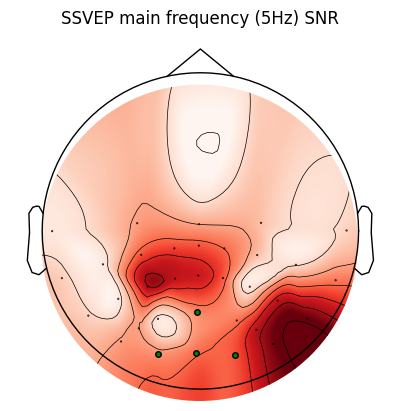

SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 10.509677708344478
average SNR (occipital ROI): 11.080177060113419


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 0.533, p = 0.607




In [93]:
from scipy.stats import ttest_rel

# Get average SNR at 5 Hz for ALL channels
snrs_5hz = snrs[:, :, i_bin_5hz]
snrs_5hz_ch_average = snrs_5hz.mean(axis=0)

# Mask to highlight electrodes on the region of interest
roi_vis_idx = pick_channels(clean_ch, roi_vis)
roi_vis_idx.pop(0) # Oz is in POz, meaning this channel was also selected

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in roi_vis_idx else 0 for c in range(len(clean_ch))]

# Plot SNR topography
fig, ax = plt.subplots(1)
ax.set_title("SSVEP main frequency (5Hz) SNR")
mne.viz.plot_topomap(snrs_5hz_ch_average, 
                     ssvep_epochs.info,
                     mask = np.array(highlight_ch), 
                     mask_params = mk,
                     vlim=(1, None), 
                     axes=ax, 
                     size = 10,
                     sphere=(0.0011, 0.015, 0.12, 0.2))

print("SNR at 5 Hz SSVEP stumulation")
print(f"average SNR (all channels): {snrs_5hz_ch_average.mean()}")
print(f"average SNR (occipital ROI): {snrs_target.mean()}")
print("\n")

tstat_roi_vs_scalp = ttest_rel(snrs_target.mean(axis=1), snrs_5hz.mean(axis=1))
print("Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?")

if(tstat_roi_vs_scalp[1] > 0.05):
    print("\n----------- No ------------\n")
else:
    print("\n----------- Yes -----------\n")

print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 1st Harmonic (10 Hz)

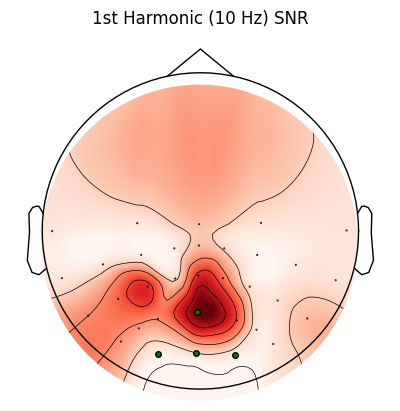

SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.725706346391135
average SNR (occipital ROI): 10.171587542166785


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = 1.744, p = 0.115




In [94]:
# Get average SNR at 5 Hz for ALL channels
snrs_10hz = snrs[:, :, i_bin_10hz]
snrs_10hz_ch_average = snrs_10hz.mean(axis=0)

# Plot SNR topography
fig, ax = plt.subplots(1)
ax.set_title("1st Harmonic (10 Hz) SNR")
mne.viz.plot_topomap(snrs_10hz_ch_average, 
                     ssvep_epochs.info, 
                     mask = np.array(highlight_ch), 
                     mask_params = mk,
                     vlim=(1, None),
                     axes=ax,
                     size = 10,
                     sphere=(0.0011, 0.015, 0.12, 0.2))

print("SNR at 5 Hz SSVEP stumulation")
print(f"average SNR (all channels): {snrs_10hz_ch_average.mean()}")
print(f"average SNR (occipital ROI): {snrs_target_h1.mean()}")
print("\n")

tstat_roi_vs_scalp = ttest_rel(snrs_target_h1.mean(axis=1), snrs_10hz.mean(axis=1))
print("Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?")

if(tstat_roi_vs_scalp[1] > 0.05):
    print("\n----------- No ------------\n")
else:
    print("\n----------- Yes -----------\n")

print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 2nd Harmonic (15 Hz)

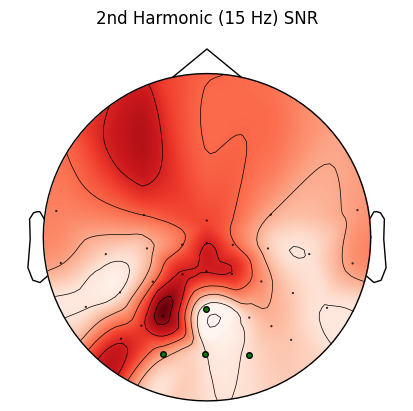

SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 4.712243763273654
average SNR (occipital ROI): 2.50249050858286


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = -4.427, p = 0.002




In [95]:
# Get average SNR at 5 Hz for ALL channels
snrs_15hz = snrs[:, :, i_bin_15hz]
snrs_15hz_ch_average = snrs_15hz.mean(axis=0)

# Plot SNR topography
fig, ax = plt.subplots(1)
ax.set_title("2nd Harmonic (15 Hz) SNR")
mne.viz.plot_topomap(snrs_15hz_ch_average, 
                     ssvep_epochs.info, 
                     mask = np.array(highlight_ch), 
                     mask_params = mk,
                     vlim=(1, None), 
                     axes=ax,
                     size = 10,
                     sphere=(-0.001, 0.0001, 0.12, 0.2))

print("SNR at 5 Hz SSVEP stumulation")
print(f"average SNR (all channels): {snrs_15hz_ch_average.mean()}")
print(f"average SNR (occipital ROI): {snrs_target_h2.mean()}")
print("\n")

tstat_roi_vs_scalp = ttest_rel(snrs_target_h2.mean(axis=1), snrs_15hz.mean(axis=1))
print("Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?")

if(tstat_roi_vs_scalp[1] > 0.05):
    print("\n----------- No ------------\n")
else:
    print("\n----------- Yes -----------\n")

print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

## ICA
https://mne.tools/mne-icalabel/stable/generated/examples/00_iclabel.html

In [96]:
'''
from mne.preprocessing import ICA
from mne_icalabel import label_components

raw_template = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()
raw_temp = mne.io.RawArray(raw_template, new_info)

copy_raw_data = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()
copy_raw = mne.io.RawArray(copy_raw_data, new_info)
copy_raw.set_montage('standard_1005')
copy_raw.set_eeg_reference("average")
filt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)
'''

'\nfrom mne.preprocessing import ICA\nfrom mne_icalabel import label_components\n\nraw_template = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()\nraw_temp = mne.io.RawArray(raw_template, new_info)\n\ncopy_raw_data = raw_eeg.copy().crop(tmin = emg_begin_sample/fs, tmax = ssvep_falling_edges[-1]/fs).pick(eeg_ch_idx).get_data()\ncopy_raw = mne.io.RawArray(copy_raw_data, new_info)\ncopy_raw.set_montage(\'standard_1005\')\ncopy_raw.set_eeg_reference("average")\nfilt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)\n'

In [97]:
'''
ica = ICA(
    n_components=33,
    max_iter="auto",
    method="infomax",
    random_state=42,
    fit_params=dict(extended=True),
)

ica.fit(filt_raw)
'''


'\nica = ICA(\n    n_components=33,\n    max_iter="auto",\n    method="infomax",\n    random_state=42,\n    fit_params=dict(extended=True),\n)\n\nica.fit(filt_raw)\n'

In [98]:
'''
ica.plot_components(size = 10,
                    sphere=(0.0011, 0.015, 0.12, 0.2));
'''

'\nica.plot_components(size = 10,\n                    sphere=(0.0011, 0.015, 0.12, 0.2));\n'

In [99]:
'''
ic_labels = label_components(filt_raw, ica, method="iclabel")

# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline 

for comp in range(10):
    print(f"\n---------------- Component {comp}: {ic_labels['labels'][comp]} ----------------\n")

    ica.plot_properties(eeg_smearing, 
                        picks=[comp], 
                        psd_args = dict(fmin=1, fmax=27),
                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));
    
    ica.plot_overlay(eeg_smearing, 
                     exclude=[comp]);
'''

'\nic_labels = label_components(filt_raw, ica, method="iclabel")\n\n# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline \n\nfor comp in range(10):\n    print(f"\n---------------- Component {comp}: {ic_labels[\'labels\'][comp]} ----------------\n")\n\n    ica.plot_properties(eeg_smearing, \n                        picks=[comp], \n                        psd_args = dict(fmin=1, fmax=27),\n                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));\n    \n    ica.plot_overlay(eeg_smearing, \n                     exclude=[comp]);\n'

In [100]:
'''
labels = ic_labels["labels"]

exclude_idx = [
    idx for idx, label in enumerate(labels) if label not in ["other",
                                                             "eye blink",
                                                             "brain", 
                                                             "heart beat",
                                                             "line noise"
                                                            ] 
                                                and idx < 10
]

print(f"Excluding these ICA components: {exclude_idx}")

ica.apply(eeg_smearing, exclude=exclude_idx)
'''

'\nlabels = ic_labels["labels"]\n\nexclude_idx = [\n    idx for idx, label in enumerate(labels) if label not in ["other",\n                                                             "eye blink",\n                                                             "brain", \n                                                             "heart beat",\n                                                             "line noise"\n                                                            ] \n                                                and idx < 10\n]\n\nprint(f"Excluding these ICA components: {exclude_idx}")\n\nica.apply(eeg_smearing, exclude=exclude_idx)\n'

In [101]:
# Events only require the sample where the trials start. mne.Epochs with t_min accounts for the desired offset based on the sample where a trial begins
events = np.vstack((t_events,nt_events))
events_id = dict(target=1, nontarget=0)

sorted_events = events[events[:, 0].argsort()]  # Sort by first column (index 0)

custom_epochs = mne.Epochs(eeg_smearing,
                           sorted_events, 
                           event_id = events_id, 
                           tmin = preStim_offset, 
                           tmax = posStim_offset, 
                           baseline = None, 
                           event_repeated = 'error',
                           preload = True)

target_eeg_blocks = custom_epochs["target"].get_data()
nontarget_eeg_blocks = custom_epochs["nontarget"].get_data()

Not setting metadata
1944 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1944 events and 1640 original time points ...


0 bad epochs dropped


C:\Users\VascoRocha(1161216)\AppData\Local\Temp\ipykernel_17612\1585184596.py:16: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  target_eeg_blocks = custom_epochs["target"].get_data()
C:\Users\VascoRocha(1161216)\AppData\Local\Temp\ipykernel_17612\1585184596.py:17: FutureWarning: The current default of copy=False will change to copy=True in 1.7. Set the value of copy explicitly to avoid this warning
  nontarget_eeg_blocks = custom_epochs["nontarget"].get_data()


Removing the 6 ICA label (with the rest line noise and muscle artifacts), probably containing the SSVEP component and its harmonics did in fact improve the issue with the SNR over the occipital region by reducing the SNR in this region in comparison to the average SNR in the rest of the channels. However, the ERPs suffered with it and the 15 Hz noise did not disappear (weird oscillation on the P3). The n2pc did in fact appear to improve with no effect on N2pcb. Some classification did improve but the x and y estimation suffered.

-----------------------------------------------------

SNR overall:

* Average SNR (occipital ROI) (5hz): 1.5238053671052734

* Average SNR (occipital ROI) (10hz): 0.5730331911747106

* Average SNR (occipital ROI) (15Hz): 0.953175827740842

- SSVEP frequency t test: t = -0.302, p = 0.768

- Harmonic 10 Hz t test: t = 0.377, p = 0.712

- Harmonic 15 Hz t test: t = 0.745, p = 0.470


--------

Without the 6 ICA comp (the other components were removed) the SNR was lightly reduced but the SNR over the occipital region remained very similar, meaning that the 10Hz harmonic over this region still remained statistically different

SNR overall:

* Average SNR (occipital ROI) (5Hz): 2.6011588592632156

* Average SNR (occipital ROI) (10Hz): 1.2433214279200635

* Average SNR (occipital ROI) (15Hz): 1.0491748678033437

- SSVEP frequency t test: t = 0.883, p = 0.393

- Harmonic 10 Hz t test: t = 2.216, p = 0.045

- Harmonic 15 Hz t test: t = 0.868, p = 0.401

--------

To see this ICA component use the whole signal to fit and nost just from the EOG recording: copy_raw_data = raw_eeg.copy().pick(eeg_ch_idx).get_data()

Also, to see better the effects of ICA on the Eye blinks use raw_temp EEG.

    ica.plot_properties(raw_temp, 
                        picks=[comp], 
                        psd_args = dict(fmin=1, fmax=27),
                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));
    
    ica.plot_overlay(raw_temp, 
                     exclude=[comp]);

## xDawn

In [102]:
'''
from mne.viz import plot_epochs_image
plot_epochs_image(custom_epochs["target"], picks=15, vmin=-10, vmax=10);
'''

'\nfrom mne.viz import plot_epochs_image\nplot_epochs_image(custom_epochs["target"], picks=15, vmin=-10, vmax=10);\n'

In [103]:
'''
from mne import compute_raw_covariance
from mne.preprocessing import Xdawn

signal_cov = compute_raw_covariance(eeg_smearing, picks = clean_ch)

xdawn = Xdawn(n_components=2, signal_cov = signal_cov)
xdawn.fit(custom_epochs[0:600])

epochs_denoised = xdawn.apply(custom_epochs)

# Plot image epoch after Xdawn
plot_epochs_image(epochs_denoised, picks = 15, vmin=-500, vmax=500)
'''


'\nfrom mne import compute_raw_covariance\nfrom mne.preprocessing import Xdawn\n\nsignal_cov = compute_raw_covariance(eeg_smearing, picks = clean_ch)\n\nxdawn = Xdawn(n_components=2, signal_cov = signal_cov)\nxdawn.fit(custom_epochs[0:600])\n\nepochs_denoised = xdawn.apply(custom_epochs)\n\n# Plot image epoch after Xdawn\nplot_epochs_image(epochs_denoised, picks = 15, vmin=-500, vmax=500)\n'

## Baseline correction

In [104]:

ERP_times = np.arange(preStim_offset, posStim_offset+1/fs, 1/fs )
t_zero = np.argmin(np.abs(ERP_times - 0))

baseline_corr_targets = np.zeros((np.shape(target_eeg_blocks)))
baseline_corr_nontargets = np.zeros((np.shape(nontarget_eeg_blocks)))

# Target
for count, trial in enumerate(target_eeg_blocks):
    for c in range(len(eeg_ch_idx)):
        baseline = np.mean(trial[c][:t_zero])
        baseline_corr_targets[count][c] = trial[c] - baseline

# Non Target
for count, trial in enumerate(nontarget_eeg_blocks):
    for c in range(len(eeg_ch_idx)):
        baseline = np.mean(trial[c][:t_zero])
        baseline_corr_nontargets[count][c] = trial[c] - baseline

# **Topoplot map of the EEG electrodes**

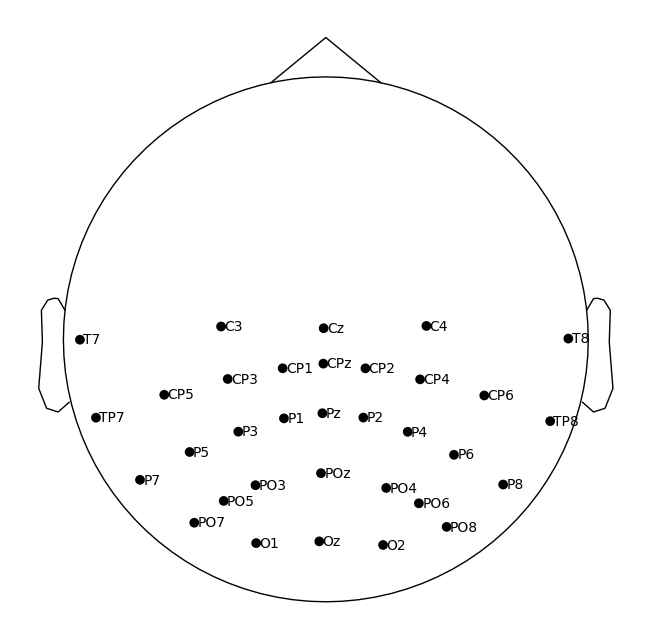

In [105]:
eeg_smearing.plot_sensors(show_names=True,
                          sphere=(0.0011, 0.015, 0.12, 0.2));

# **ERP Analysis**

## Computing and plotting ERPs: P3 (300 - 500 ms)

In [138]:
target_ERP = np.mean(baseline_corr_targets, axis = 0) # Averaging over the trials dimension
nontarget_ERP = np.mean(baseline_corr_nontargets, axis = 0)

P3_channels = [" Cz", " CPz", " Pz"]

P3_ch_idx = pick_channels(ch, P3_channels)

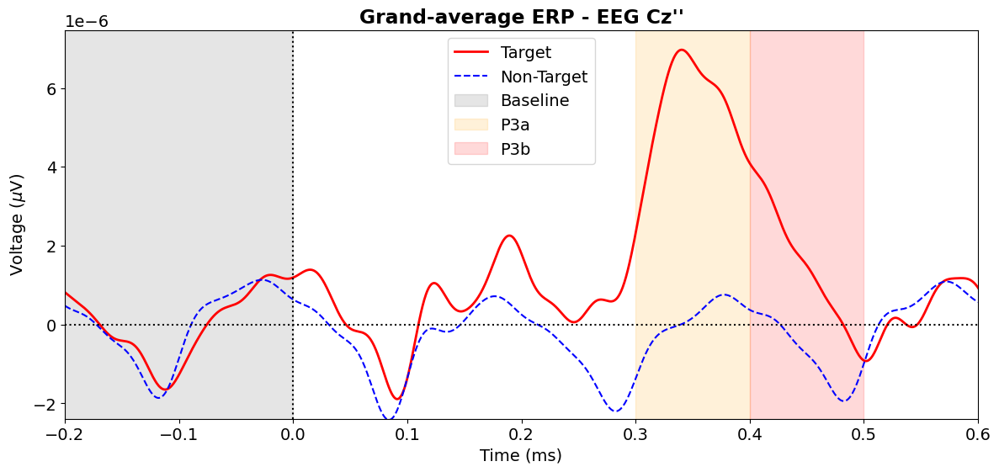

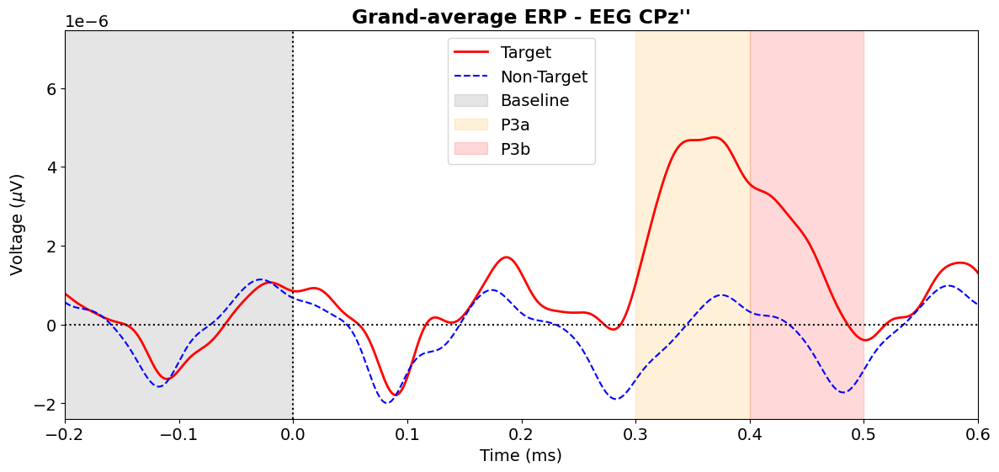

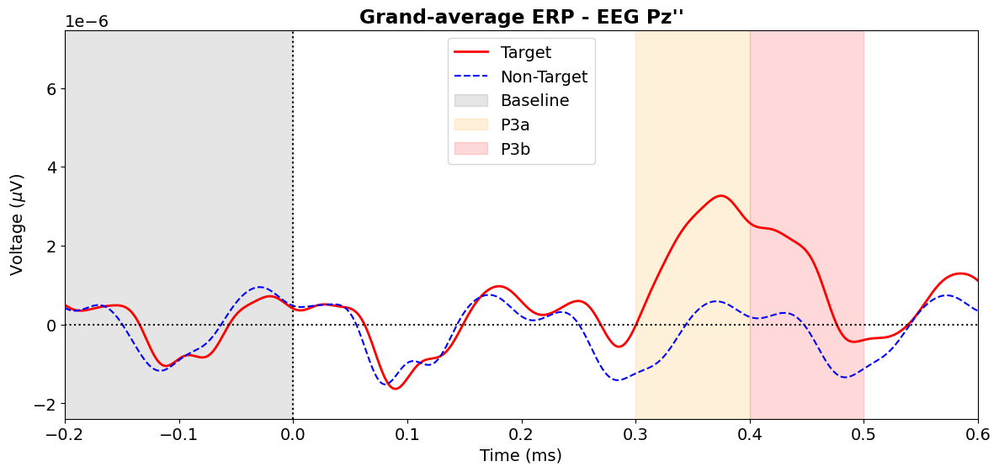

In [139]:
import matplotlib.patches as patches

for c in P3_ch_idx:
    fig, ax = plt.subplots(figsize=(14, 6))
    plt.plot(ERP_times, target_ERP[c], color = 'red', label = 'Target',  linewidth = 2);
    plt.plot(ERP_times, nontarget_ERP[c], 'b--', label = 'Non-Target');
    plt.title(f"Grand-average ERP - {ch[c]}", weight = 'bold')
    plt.xlabel("Time (ms)")
    plt.ylabel("Voltage ($\mu$V)")
    plt.axvline(x = 0, linestyle = ':', color = 'black')
    plt.axhline(y = 0, linestyle = ':', color = 'black')
    plt.xlim([preStim_offset,posStim_offset])
    plt.ylim([np.min(target_ERP[P3_ch_idx]) - 0.5 * 10**(-6),np.max(target_ERP[P3_ch_idx]) + 0.5 * 10**(-6)])

    baseline_region = patches.Rectangle((-0.2, -0.1), 0.2, 0.2, linewidth = 1, edgecolor = 'black', facecolor = 'black', alpha = 0.1, label = 'Baseline')
    ax.add_patch(baseline_region)

    if c in P3_ch_idx:
        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.3, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax.add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.4, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax.add_patch(P3b_region)
        
    plt.legend()
    plt.show()

## Target vs Non-target Topomaps

Max vlim:  6.970895355730504e-06
Min vlim:  -9.26229971874503e-07


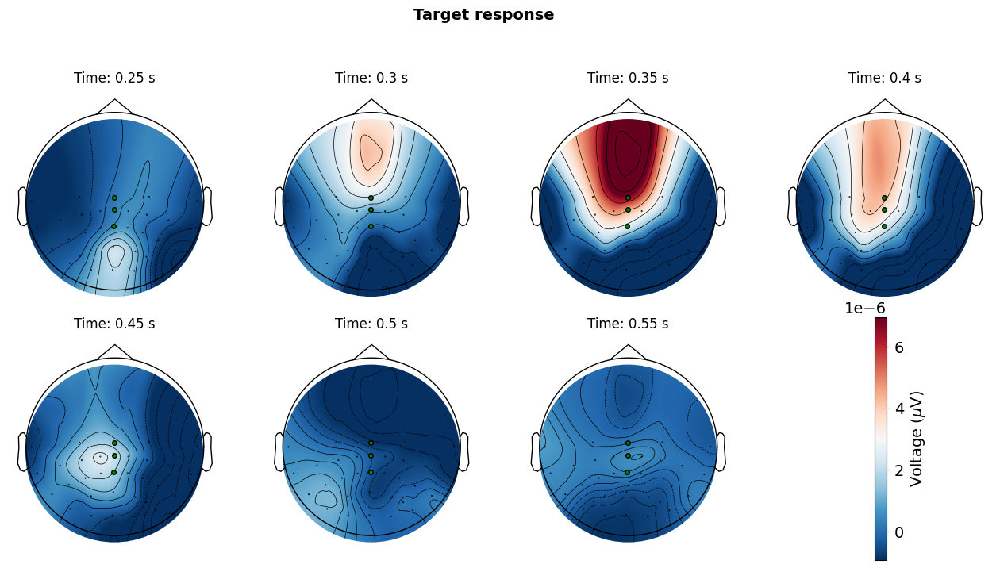

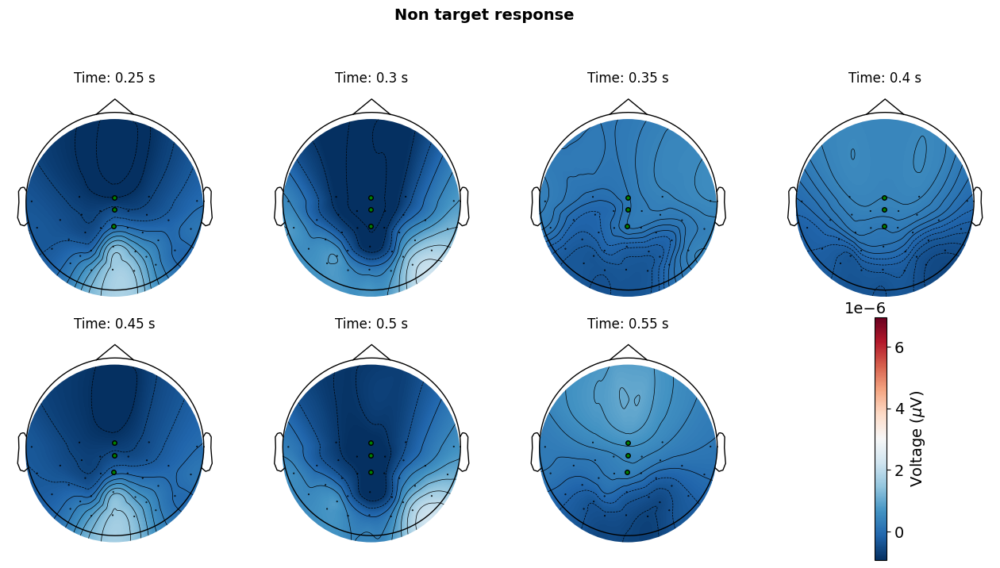

In [140]:
t_win = 0.01  # seconds

t_intervals = [0.25, 
               0.3, 
               0.35, 
               0.4, 
               0.45, 
               0.5, 
               0.55,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(target_ERP[P3_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(target_ERP[P3_ch_idx,t_sample_start:t_sample_stop]) 

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(16, 8))

fig.suptitle("Target response", fontweight='bold', fontsize=14)

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in P3_ch_idx else 0 for c in range(len(clean_ch))]

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(target_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(16, 8))

fig.suptitle("Non target response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(nontarget_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

## Target vs Non-target classification (P3)

In [180]:
from scipy.signal import resample

# Isolating the datapoints related to the N2pc time window 

n_trials = np.size(baseline_corr_targets, 0)

ts = 0.3
te = 0.5

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

featVect_Target = [] # Class label = 0
featVect_NonTarget = [] # Class label = 1

for trial in range(n_trials):

    targets = resample(baseline_corr_targets[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    nontargets = resample(baseline_corr_nontargets[trial*3][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for id, c in enumerate(P3_ch_idx, 1):

        if (id == 1):
            auxT = np.hstack((targets[P3_ch_idx[id - 1],:],targets[c,:]))
            auxNT = np.hstack((nontargets[P3_ch_idx[id - 1],:],nontargets[c,:]))
        else:
            auxT = np.hstack((auxT,targets[c,:]))
            auxNT = np.hstack((auxNT,nontargets[c,:]))
    
    featVect_Target.append(np.hstack((auxT, 0)))
    featVect_NonTarget.append(np.hstack((auxNT, 1)))

print(np.shape(featVect_Target))
print(np.shape(featVect_NonTarget))

(240, 57)
(240, 57)


In [181]:
import random

PERCENT_TRAIN = 0.75

n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

train_featVect = np.vstack((featVect_Target[:n_train], featVect_NonTarget[:n_train]))
test_featVect = np.vstack((featVect_Target[n_train:], featVect_NonTarget[n_train:]))

random.seed(42)
np.random.shuffle(train_featVect)
random.seed(42)
np.random.shuffle(test_featVect)

In [182]:
# Feature wise normalization of feature vector
n_entries = np.size(train_featVect, 0)

norm_train_featVect = []

for j in range(n_entries):

    mean = np.mean(train_featVect[j, 0:-1])
    std = np.std(train_featVect[j, 0:-1])
    norm_train_featVect.append(np.hstack(((train_featVect[j,0:-1] - mean) / std, train_featVect[j, -1])))

n_entries = np.size(test_featVect, 0)

norm_test_featVect = []

for u in range(n_entries):

    mean = np.mean(test_featVect[u,0:-1])
    std = np.std(test_featVect[u,0:-1])
    norm_test_featVect.append(np.hstack(((test_featVect[u,0:-1] - mean) / std, test_featVect[u, -1])))

train_featVect = np.array(norm_train_featVect)
test_featVect = np.array(norm_test_featVect)

In [183]:
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score, accuracy_score

kfold = 10

print("========================== Most dicriminative channels ==========================\n")

# SVM
kernel = 'sigmoid'
p3_clf1 = SVC(kernel=kernel, probability=True)
scores = cross_val_score(p3_clf1, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
p3_clf1.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = p3_clf1.predict(test_featVect[:, 0:-1])
print("------------- SVM -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], p3_clf1.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# LDA
solver = 'eigen'
p3_clf2 = LDA(solver = solver, shrinkage = 0.001)
scores = cross_val_score(p3_clf2, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
p3_clf2.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = p3_clf2.predict(test_featVect[:, 0:-1])
print("\n------------- LDA -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], p3_clf2.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Random Forest
p3_clf3 = RandomForestClassifier()  # Create an instance of Random Forest classifier
scores = cross_val_score(p3_clf3, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
p3_clf3.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = p3_clf3.predict(test_featVect[:, 0:-1])
print("\n------------- Random Forest -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], p3_clf3.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
p3_clf4 = xgb.XGBClassifier(learning_rate = 0.05)  # Create an instance of XGBoost classifier
scores = cross_val_score(p3_clf4, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
p3_clf4.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = p3_clf4.predict(test_featVect[:, 0:-1])
print("\n------------- XGBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], p3_clf4.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
p3_clf5 = AdaBoostClassifier(learning_rate = 0.05)  # Create an instance of AdaBoost classifier
scores = cross_val_score(p3_clf5, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
p3_clf5.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = p3_clf5.predict(test_featVect[:, 0:-1])
print("\n------------- AdaBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], p3_clf5.predict_proba(test_featVect[:, 0:-1])[:,1]),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== Most dicriminative channels ==========================

------------- SVM -------------
AUC:  0.72
Cross validation mean score: 0.73 +/- 0.07
Accuracy:  0.68

------------- LDA -------------
AUC:  0.77
Cross validation mean score: 0.77 +/- 0.03
Accuracy:  0.72



------------- Random Forest -------------
AUC:  0.72
Cross validation mean score: 0.7 +/- 0.04
Accuracy:  0.69

------------- XGBoost -------------
AUC:  0.73
Cross validation mean score: 0.69 +/- 0.05
Accuracy:  0.65


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost -------------
AUC:  0.72
Cross validation mean score: 0.69 +/- 0.04
Accuracy:  0.61


# **Mapping targets to object location**

------
Paths:

C:/Users/VascoRocha(1161216)/Desktop/Rocha/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/EEG_Sara_001

In [184]:
trial_order_folder = "C:/Users/VascoRocha(1161216)/Desktop/Rocha/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files_Train/EEG_01_001"
subfolders, trialfiles = run_fast_scandir(trial_order_folder, [".xlsx"])
 
import natsort
sort_trialfiles = natsort.natsorted(trialfiles)

In [185]:
import pandas as pd

centroid_mapped_targets = []
images = []

count = 0

for file in sort_trialfiles:
    sheet = pd.read_excel(file)
    
    for row in sheet.values:
        if row[2] == "Target":
            centroid_mapped_targets.append([baseline_corr_targets[count], row[-1]]) # Mapping rows || Field one comprises the data | Field two comprises the object centroid 
            images.append(row[1]) # row[0] = trial iterator
            count = count + 1

## Visual angle calculation

In [186]:
SCREEN_WIDTH_PX = 1920
SCREEN_HEIGHT_PX = 1080

SCREEN_DIAGONAL_SIZE_INCH = 27

def visual_angle(object_x_px, object_y_px, H_image_width_px, V_image_width_px, screen_width_px, screen_height_px):
    
    # https://www.reddit.com/r/oculus/comments/1dmcsh/default_eye_to_screen_distance/ corresponds to measurement
    #observer_distance_mm = 40 # in mm for the HMD (Oculus Rift)
    OBSERVER_DISTANCE_MM = 1000 # in mm for the C1 computer

    # Width and Height of the screen in mm
    SCREEN_WIDTH_MM = 699
    SCREEN_HEIGHT_MM = 395
 
    # Convert the size of the image in pixels to mm
    H_image_width_mm = (SCREEN_WIDTH_MM * H_image_width_px)/screen_width_px
    V_image_width_mm = (SCREEN_HEIGHT_MM * V_image_width_px)/screen_height_px

    # Visual angle of the image
    H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
    V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

    # How many degrees in the visual field represents one pixel in the images
    H_visual_angle_per_px = H_image_width_deg / H_image_width_px 
    V_visual_angle_per_px = V_image_width_deg / V_image_width_px

    H_object_x_deg = (object_x_px - (H_image_width_px / 2)) * H_visual_angle_per_px
    V_object_y_deg = (object_y_px - (V_image_width_px / 2)) * V_visual_angle_per_px

    return H_object_x_deg, V_object_y_deg

In [187]:
x,y=visual_angle(1344/2, 1134/2, 1344/2, 1134/2, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)
print(x,y)

6.974058729692531 5.91970218693015


In [188]:
# This is for the PsycgoPy -> trial -> trialImage -> Layout -> Size[w,h] $
wPx = 1344
hPx = 1134

print(f"Size [{round(wPx * 0.5 / hPx, 3)}, 0.5]") # This mantains the proportion of width and height in the scalling done in PsychoPy

wPx = wPx * 0.5 # px
hPx = hPx * 0.5 # px

# Now we have to define how to devide the visual field for the VR headset
# In the original study had a width of 11.5 x 11.8 degrees and 640 x 640 in pixels. 
# Also, a threshold of +/- 1.2 degrees to classify the images for the LVF and RVF 

#observer_distance_mm = 40
OBSERVER_DISTANCE_MM = 1000

# Inches to mm the screen size
screen_diagonal_size_mm = SCREEN_DIAGONAL_SIZE_INCH * 25.4 

# Angle of the diagonal of the screen
width_height_angle = np.arctan(SCREEN_HEIGHT_PX/SCREEN_WIDTH_PX) # C_oposed/C_adjacent

# Width and Height of the screen in mm
screen_width_mm = 696
screen_height_mm = 395

# Convert the size of the image in pixels to mm
H_image_width_mm = (screen_width_mm * wPx)/SCREEN_WIDTH_PX
V_image_width_mm = (screen_height_mm * hPx)/SCREEN_HEIGHT_PX

# Visual angle of the image
H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

print("\nWidth of the image in degrees: ", round(H_image_width_deg,3))
print("Height of the image in degrees: ", round(V_image_width_deg,3))

# Paper on Eccentricity of the target stimuli and the N2pc performance: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7160023/pdf/nihms-1065363.pdf 

Size [0.593, 0.5]

Width of the image in degrees:  13.889
Height of the image in degrees:  11.839


## Labelling targets according to the centroid location

In [189]:
import re

H_th = 1.2 # Degrees
V_th = 1.2

PYSCHOPY_RESCALLING = 0.5

IM_WIDTH = 1344 * PYSCHOPY_RESCALLING
IM_HEIGHT = 1134 * PYSCHOPY_RESCALLING

labelled_targets = []

for count, (target_EEG, centroid_str) in enumerate(centroid_mapped_targets):

    # Remove unnecessary characters and split by comma
    cleaned_string = centroid_str[2:-2].split(",")  # Removes [' and '] and splits at ','
    # Extract integers after '=' sign
    centroid = [int(s.split("=")[1]) for s in cleaned_string]

    x_VA, y_VA = visual_angle(centroid[0], centroid[1], IM_WIDTH, IM_HEIGHT, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)

    if (x_VA > H_th):
        x_stim_type = "RVF"
    elif (x_VA < -H_th):
        x_stim_type = "LVF"
    else:
        x_stim_type = "CVF"

    if(y_VA < -V_th):
        y_stim_type = "TVF"
    elif (y_VA > V_th):
        y_stim_type = "BVF"
    else:
        y_stim_type = "CVF"

    labelled_targets.append([target_EEG, centroid[0], centroid[1], x_VA, y_VA, x_stim_type, y_stim_type])

print(np.shape(labelled_targets))
           

(240, 7)


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\fromnumeric.py:2009: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = asarray(a).shape


# **Averaging Contralateral - Ipsilateral component: N2pc (200 - 400 ms)**

## Separating and concatenating classes

In [190]:
left_N2pc_channels = [" P7", " PO7", " PO3", " PO5", " P5", " O1"]
right_N2pc_channels = [" P8", " PO8", " PO4", " PO6", " P4", " O2"]

left_N2pc_ch_idx = pick_channels(ch, left_N2pc_channels)
right_N2pc_ch_idx = pick_channels(ch, right_N2pc_channels)

LVF_contralateral = []
LVF_ipsilateral = []
RVF_contralateral = []
RVF_ipsilateral = []
CVF_contralateral = []
CVF_ipsilateral = []

LVF_target = []
RVF_target = []

RVF_x_pos = []
LVF_x_pos = []
CVF_x_pos = []

RVF_y_pos = []
LVF_y_pos = []
CVF_y_pos = []

HORIZONTAL_CONDITION_COL = 5
HORIZONTAL_VA_COL = 3
X_CENTROID_COL = 1
DATA_COL = 0

VERTICAL_CONDITION_COL = 6
VERTICAL_VA_COL = 4
Y_CENTROID_COL = 2

for trial in labelled_targets:
    if(trial[HORIZONTAL_CONDITION_COL] == "RVF"):
        RVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
        RVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

        RVF_x_pos.append(trial[X_CENTROID_COL])
        RVF_y_pos.append(trial[Y_CENTROID_COL])

        RVF_target.append(trial[DATA_COL])

    elif(trial[HORIZONTAL_CONDITION_COL] == "LVF"):
        LVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
        LVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

        LVF_x_pos.append(trial[X_CENTROID_COL])
        LVF_y_pos.append(trial[Y_CENTROID_COL])

        LVF_target.append(trial[DATA_COL])

    elif(trial[HORIZONTAL_CONDITION_COL] == "CVF" and trial[HORIZONTAL_VA_COL >= -H_th] and trial[HORIZONTAL_VA_COL] < 0):
        CVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
        CVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

        CVF_y_pos.append(trial[Y_CENTROID_COL])
        CVF_x_pos.append(trial[X_CENTROID_COL])

    elif(trial[HORIZONTAL_CONDITION_COL] == "CVF" and trial[HORIZONTAL_VA_COL > 0] and trial[HORIZONTAL_VA_COL] <= H_th):
        CVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
        CVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

        CVF_y_pos.append(trial[Y_CENTROID_COL])
        CVF_x_pos.append(trial[X_CENTROID_COL])

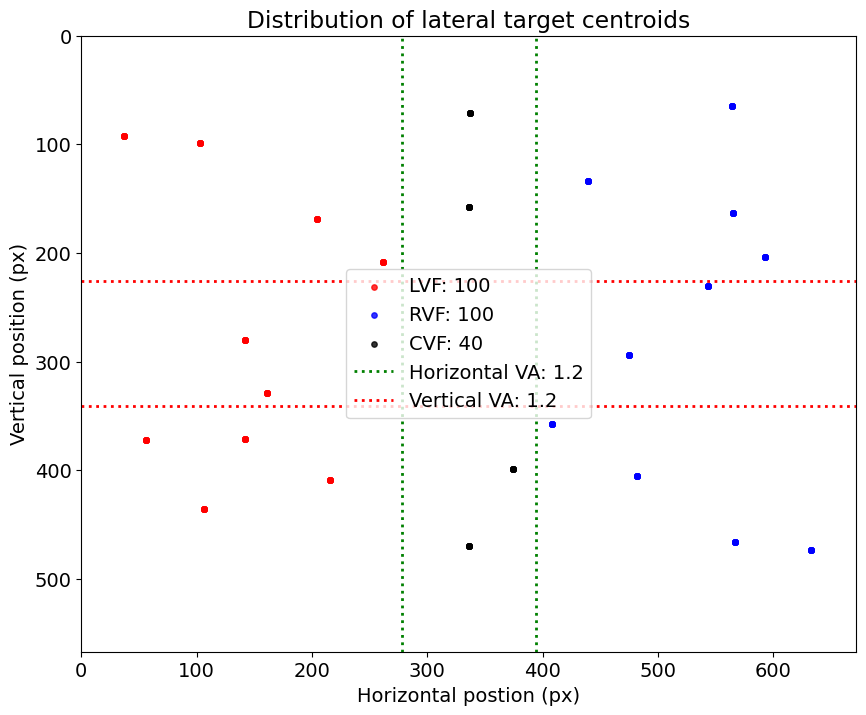

In [191]:
width = 672
height = 567

figure(figsize = (10, 8))

plt.title("Distribution of lateral target centroids")
plt.scatter(LVF_x_pos, LVF_y_pos, color = 'r', s = 15, alpha = 0.8, label = f"LVF: {len(LVF_x_pos)}");
plt.scatter(RVF_x_pos, RVF_y_pos, color = 'b', s = 15, alpha = 0.8, label = f"RVF: {len(RVF_x_pos)}");
plt.scatter(CVF_x_pos, CVF_y_pos, color = 'k', s = 15, alpha = 0.8, label = f"CVF: {len(CVF_x_pos)}");

plt.xlabel("Horizontal postion (px)")
plt.ylabel("Vertical position (px)")
plt.legend(loc = "best");

plt.axvline(x = 278, color = 'g', linestyle = ':', linewidth = 2, label = f"Horizontal VA: {H_th}")
plt.axvline(x = 394, color = 'g', linestyle = ':', linewidth = 2)

plt.axhline(y = 226, color = 'r', linestyle = ':', linewidth = 2, label = f"Vertical VA: {V_th}")
plt.axhline(y = 341, color = 'r', linestyle = ':', linewidth = 2)

plt.xlim([0, width]);
plt.ylim([height, 0])

plt.legend()
plt.show()

In [192]:
print("RVF Contralateral trial number:", np.shape(RVF_contralateral))
print("RVF Ipsilateral trial number:", np.shape(RVF_ipsilateral))
print("LVF Contralateral trial number:", np.shape(LVF_contralateral))
print("LVF Ipsilateral trial number:", np.shape(LVF_ipsilateral))
print("CVF Contralateral trial number:", np.shape(CVF_contralateral))
print("CVF Ipsilateral trial number:", np.shape(CVF_ipsilateral))


RVF Contralateral trial number: (100, 6, 1640)
RVF Ipsilateral trial number: (100, 6, 1640)
LVF Contralateral trial number: (100, 6, 1640)
LVF Ipsilateral trial number: (100, 6, 1640)
CVF Contralateral trial number: (40, 6, 1640)
CVF Ipsilateral trial number: (40, 6, 1640)


## Grand-Average

In [193]:
RVF_aver_contralateral = np.mean(RVF_contralateral, axis = 0)
RVF_aver_ipsilateral = np.mean(RVF_ipsilateral, axis = 0)
LVF_aver_contralateral = np.mean(LVF_contralateral, axis = 0)
LVF_aver_ipsilateral = np.mean(LVF_ipsilateral, axis = 0)

aver_cont = (RVF_aver_contralateral + LVF_aver_contralateral)/2
aver_ipsi = (RVF_aver_ipsilateral + LVF_aver_ipsilateral)/2

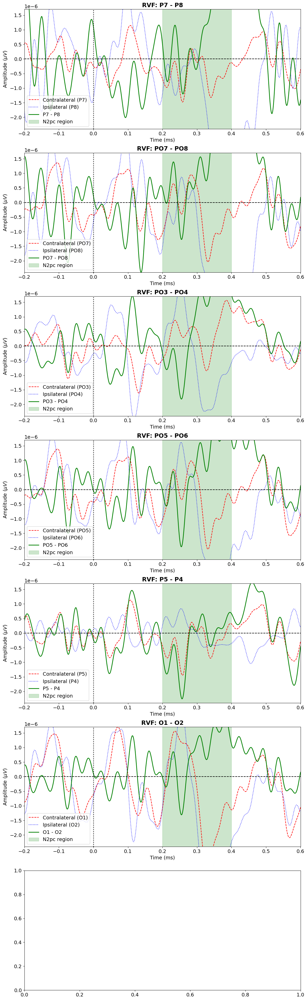

In [194]:
fig, ax = plt.subplots(figsize=(14, 50), nrows=7, ncols=1)

pos = [[0, 0], [1, 0], [2, 0], [3,0], [4,0], [5,0], [6,0]]

up_vlim = np.max(RVF_aver_contralateral)
do_vlim = np.min(RVF_aver_contralateral - RVF_aver_ipsilateral)

for i in range(len(left_N2pc_ch_idx)):

    N2pc = RVF_aver_contralateral[i] - RVF_aver_ipsilateral[i]

    ax[pos[i][0]].plot(ERP_times, RVF_aver_contralateral[i],'r--', label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    ax[pos[i][0]].plot(ERP_times, RVF_aver_ipsilateral[i],'b:', label = f"Ipsilateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    ax[pos[i][0]].plot(ERP_times, N2pc,'g', label = f"{clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[pos[i][0]].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[pos[i][0]].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[pos[i][0]].add_patch(N2pc_region)

    ax[pos[i][0]].set_title(f"RVF: {clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[pos[i][0]].set_xlabel('Time (ms)')
    ax[pos[i][0]].set_ylabel('Amplitude ($\mu V$)')
    ax[pos[i][0]].legend(loc = 'lower left')

    ax[pos[i][0]].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[pos[i][0]].axhline(y=0, color = 'k', linestyle = 'dashed')

    #ax[pos[i][0],pos[i][1]].invert_yaxis()

plt.show()

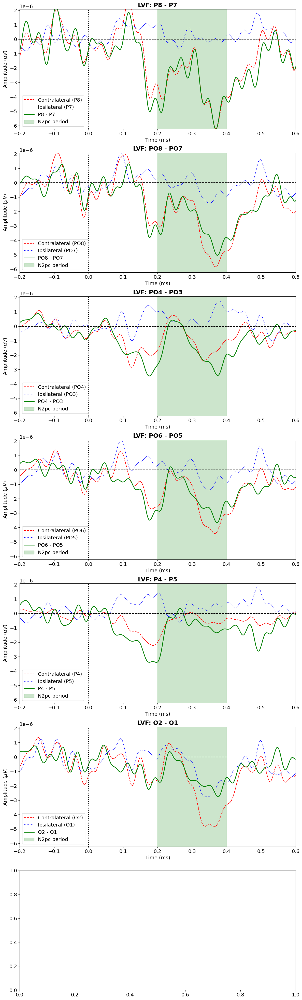

In [195]:
fig, ax = plt.subplots(figsize=(14, 50), nrows=7, ncols=1)

up_vlim = np.max(LVF_aver_ipsilateral)
do_vlim = np.min(LVF_aver_contralateral)

for i in range(len(left_N2pc_ch_idx)):

    N2pc = LVF_aver_contralateral[i] - LVF_aver_ipsilateral[i]

    ax[pos[i][0]].plot(ERP_times, LVF_aver_contralateral[i],'r--', label = f"Contralateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    ax[pos[i][0]].plot(ERP_times, LVF_aver_ipsilateral[i],'b:', label = f"Ipsilateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    ax[pos[i][0]].plot(ERP_times, N2pc,'g', label = f"{clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[pos[i][0]].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[pos[i][0]].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = 'N2pc period')

    ax[pos[i][0]].add_patch(N2pc_region)

    ax[pos[i][0]].set_title(f"LVF: {clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[pos[i][0]].set_xlabel('Time (ms)')
    ax[pos[i][0]].set_ylabel('Amplitude ($\mu V$)')
    ax[pos[i][0]].legend(loc='lower left')

    ax[pos[i][0]].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[pos[i][0]].axhline(y=0, color = 'k', linestyle = 'dashed')

    #ax[pos[i][0],pos[i][1]].invert_yaxis()
    
plt.show()

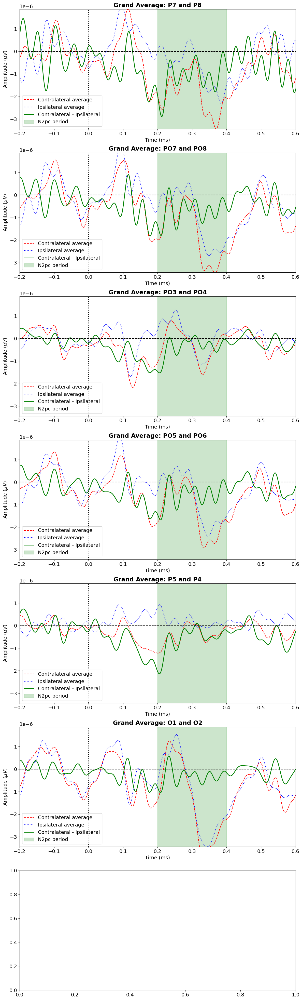

In [196]:
fig, ax = plt.subplots(figsize=(14, 50), nrows=7, ncols=1)

up_vlim = np.max(aver_cont)
do_vlim = np.min(aver_ipsi)

for i in range(len(left_N2pc_ch_idx)):

    N2pc = aver_cont[i] - aver_ipsi[i]

    ax[pos[i][0]].plot(ERP_times, aver_cont[i],'r--', label = 'Contralateral average')
    ax[pos[i][0]].plot(ERP_times, aver_ipsi[i],'b:', label = 'Ipsilateral average')
    ax[pos[i][0]].plot(ERP_times, N2pc,'g', label = "Contralateral - Ipsilateral", linewidth = 2)

    ax[pos[i][0]].set_xlim([np.min(ERP_times), np.max(ERP_times)])
    ax[pos[i][0]].set_ylim([do_vlim, up_vlim])

    N2pc_region = patches.Rectangle((0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[pos[i][0]].add_patch(N2pc_region)

    ax[pos[i][0]].set_title(f"Grand Average: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[pos[i][0]].set_xlabel('Time (ms)')
    ax[pos[i][0]].set_ylabel('Amplitude ($\mu V$)')
    ax[pos[i][0]].legend(loc='lower left')

    ax[pos[i][0]].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[pos[i][0]].axhline(y=0, color = 'k', linestyle = 'dashed')

    #ax[pos[i][0],pos[i][1]].invert_yaxis()

plt.show()

## RVF vs LVF Topomaps

Max vlim:  1.9017623042221033e-06
Min vlim:  -6.226538213670453e-06


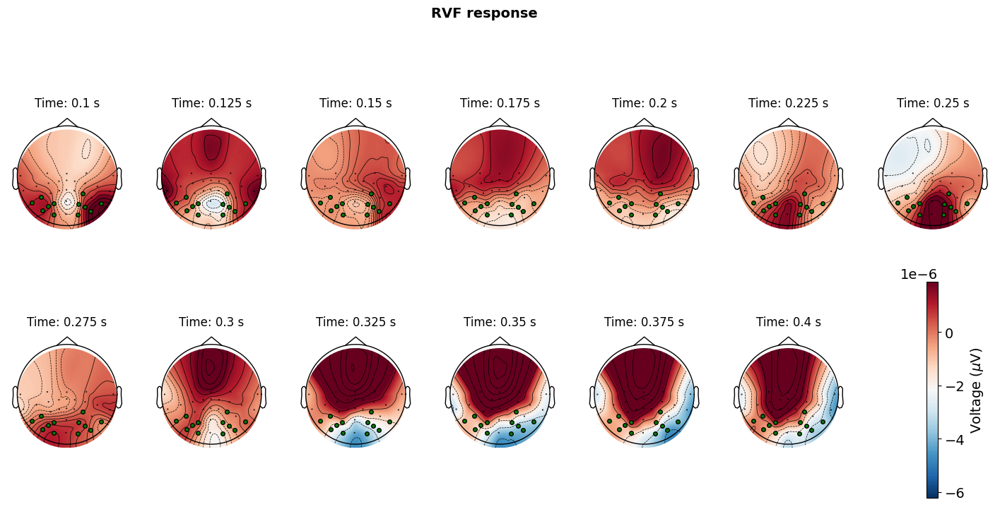

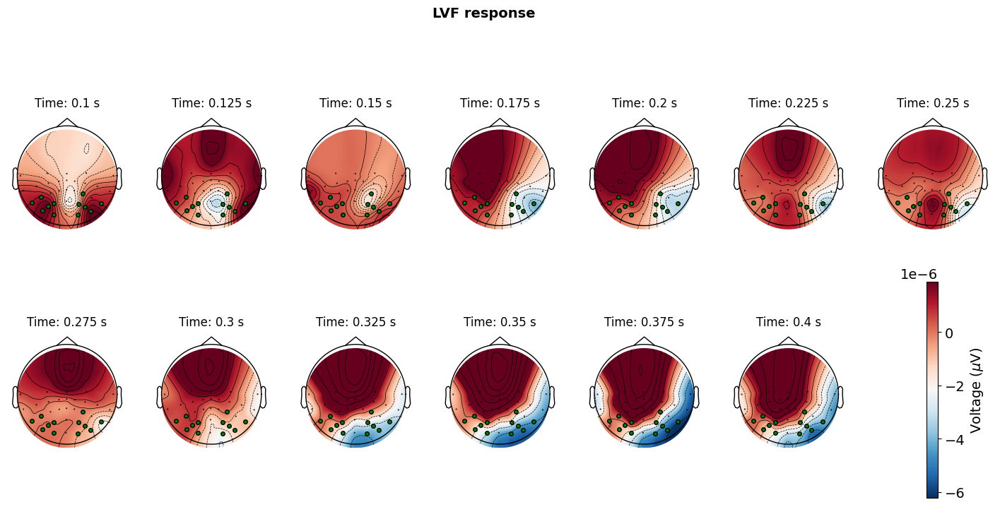

In [197]:
LVF_ERP = np.mean(LVF_target, axis = 0)
RVF_ERP = np.mean(RVF_target, axis = 0)

t_win = 0.005

t_intervals = [0.10,
               0.125,
               0.15,
               0.175,
               0.2,
               0.225, 
               0.25, 
               0.275, 
               0.3, 
               0.325, 
               0.35, 
               0.375,
               0.40,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(LVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(LVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))


# --------------------------------------------- RVF ---------------------------------------------

fig.suptitle("RVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01) 
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

# --------------------------------------------- LVF ---------------------------------------------

fig.suptitle("LVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

## Calculate the single-trial N2pc component

In [198]:
from scipy.signal import resample

# Isolating the datapoints related to the N2pc time window 

n_trials, n_channels, _ = np.shape(RVF_contralateral)

ts = 0.2
te = 0.4

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

featVectLVF = [] # Class label = 0
featVectRVF = [] # Class label = 1

NN_featVectLVF = []
NN_featVectRVF = []

for trial in range(n_trials):

    LVF = resample(LVF_contralateral[trial][:,idx_s:idx_e+1] - LVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    RVF = resample(RVF_contralateral[trial][:,idx_s:idx_e+1] - RVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            #auxCVF = np.hstack((CVF[c-1,:],CVF[c,:]))
            auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
            auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
        else:
            #auxCVF = np.hstack((auxCVF,CVF[c,:]))
            auxLVF = np.hstack((auxLVF,LVF[c,:]))
            auxRVF = np.hstack((auxRVF,RVF[c,:]))
    
    '''
    if(trial >= 0 and trial <= 30):
        plt.plot(LVF[0], "b:", label = "LVF")
        plt.plot(RVF[0], "r", label = "RVF")
        plt.legend()
        plt.show()
    '''

    featVectLVF.append(np.hstack((auxLVF, 0)))
    featVectRVF.append(np.hstack((auxRVF, 1)))

    NN_featVectLVF.append(np.hstack((auxLVF, LVF_x_pos[trial])))
    NN_featVectRVF.append(np.hstack((auxRVF, RVF_x_pos[trial])))

print(np.shape(featVectLVF))
print(np.shape(featVectRVF))

(100, 85)
(100, 85)


# **Classifying N2pc: RVF vs LVF**

## Train/Test Split and concatenate feature vectors for all channel differences

In [199]:
n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

train_featVect = np.vstack((featVectLVF[:n_train], featVectRVF[:n_train]))
test_featVect = np.vstack((featVectLVF[n_train:], featVectRVF[n_train:]))

random.seed(42)
np.random.shuffle(train_featVect)
random.seed(42)
np.random.shuffle(test_featVect)


## Row-wise normalization of the feature vector

Improved Model Performance: Many machine learning algorithms, especially those based on distances (e.g., k-Nearest Neighbors, SVMs), rely on the relative scales of features. Standardization ensures all features contribute equally to the distance calculations, potentially leading to better model performance.


Faster Convergence: In neural networks and other gradient-based optimization algorithms, standardization can help them converge faster during training.

In [200]:
# Feature wise normalization of feature vector
n_entries = np.size(train_featVect, 0)

norm_train_featVect = []

for j in range(n_entries):

    mean = np.mean(train_featVect[j, 0:-1])
    std = np.std(train_featVect[j, 0:-1])
    norm_train_featVect.append(np.hstack(((train_featVect[j,0:-1] - mean) / std, train_featVect[j, -1])))

n_entries = np.size(test_featVect, 0)

norm_test_featVect = []

for u in range(n_entries):

    mean = np.mean(test_featVect[u,0:-1])
    std = np.std(test_featVect[u,0:-1])
    norm_test_featVect.append(np.hstack(((test_featVect[u,0:-1] - mean) / std, test_featVect[u, -1])))

train_featVect = np.array(norm_train_featVect)
test_featVect = np.array(norm_test_featVect)

## Column-wise normalization of the feature vector

In [201]:
'''
# Feature wise normalization of feature vector
n_entries = np.size(train_featVect, 1) - 1

norm_train_featVect = []

for j in range(n_entries):

    mean = np.mean(train_featVect[:, j])
    std = np.std(train_featVect[:, j])
    norm_train_featVect.append(((train_featVect[:, j] - mean)))

n_entries = np.size(test_featVect, 1) - 1

norm_test_featVect = []

for u in range(n_entries):

    mean = np.mean(test_featVect[:,u])
    std = np.std(test_featVect[:,u])
    norm_test_featVect.append((test_featVect[: ,u] - mean) / std)

train_featVect = np.array(np.vstack((norm_train_featVect, train_featVect[:, - 1]))).T
test_featVect = np.array(np.vstack((norm_test_featVect, test_featVect[:, - 1]))).T
'''

'\n# Feature wise normalization of feature vector\nn_entries = np.size(train_featVect, 1) - 1\n\nnorm_train_featVect = []\n\nfor j in range(n_entries):\n\n    mean = np.mean(train_featVect[:, j])\n    std = np.std(train_featVect[:, j])\n    norm_train_featVect.append(((train_featVect[:, j] - mean)))\n\nn_entries = np.size(test_featVect, 1) - 1\n\nnorm_test_featVect = []\n\nfor u in range(n_entries):\n\n    mean = np.mean(test_featVect[:,u])\n    std = np.std(test_featVect[:,u])\n    norm_test_featVect.append((test_featVect[: ,u] - mean) / std)\n\ntrain_featVect = np.array(np.vstack((norm_train_featVect, train_featVect[:, - 1]))).T\ntest_featVect = np.array(np.vstack((norm_test_featVect, test_featVect[:, - 1]))).T\n'

## Mutual Based Information

In [202]:
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest

k_feat = N_DATAPOINTS_RESA_FREQ * 4

best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(train_featVect[:,0:-1], train_featVect[:,-1]).get_support()
best_feat_idx = np.append(best_feat_idx, False)

### Distribution of channel importance for classification

In [203]:
n_ch = len(right_N2pc_ch_idx)

tf = np.zeros(n_ch)
cont = np.ones(N_DATAPOINTS_RESA_FREQ)

for i in range(n_ch):
    tf[i] = (np.sum(cont[best_feat_idx[i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

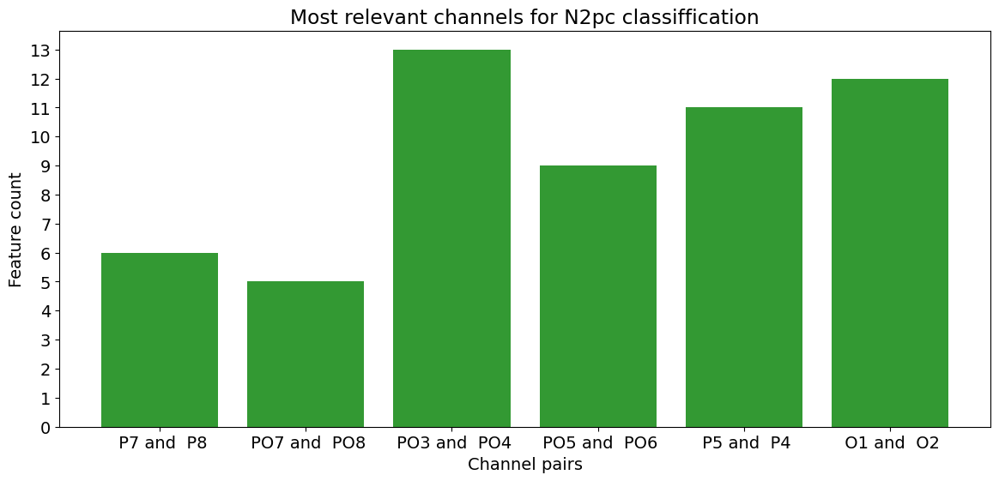

In [204]:
customlb = []
for c, lb in enumerate(left_N2pc_channels):
    customlb.append(str(lb) + " and " + str(right_N2pc_channels[c]))

fig, ax = plt.subplots(figsize=(14, 6))
plt.rcParams.update({'font.size': 14})
ax.set_title(f'Most relevant channels for N2pc classiffication')
ax.bar(np.arange(1, n_ch + 1), tf, color="g", capsize=4, alpha = 0.8)
ax.set(xticks=np.arange(1, n_ch + 1), 
       xlabel='Channel pairs', 
       yticks=np.arange(0, max(tf) + 1, step=1),
       ylabel = "Feature count")
ax.set_xticklabels(customlb);

plt.show();

### Selecting the most relevant channel for classification

In [205]:
best_channel_feat_idx = np.zeros(len(best_feat_idx))

for i in range(len(tf)):
    if(tf[i] >= sorted(tf, reverse = True)[2]):
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
    else:
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean
best_channel_feat_idx

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False])

## Classification models

#### Most dicriminative channels

In [206]:
print("========================== Most dicriminative channels ==========================\n")

# SVM
kernel = 'sigmoid'
clf1 = SVC(kernel=kernel, probability=True)
scores = cross_val_score(clf1, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf1.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf1.predict(test_featVect[:, best_channel_feat_idx])
print("------------- SVM -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf1.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# LDA
solver = 'eigen'
clf2 = LDA(solver = solver, shrinkage = 0.001)
scores = cross_val_score(clf2, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf2.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf2.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- LDA -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf2.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Random Forest
clf3 = RandomForestClassifier()  # Create an instance of Random Forest classifier
scores = cross_val_score(clf3, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf3.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf3.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- Random Forest -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf3.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf4 = xgb.XGBClassifier(learning_rate = 0.05)  # Create an instance of XGBoost classifier
scores = cross_val_score(clf4, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf4.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf4.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- XGBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf4.predict_proba(test_featVect[:,best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf5 = AdaBoostClassifier(learning_rate = 0.05)  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf5, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf5.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf5.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- AdaBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf5.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))



========================== Most dicriminative channels ==========================

------------- SVM -------------
AUC:  0.98
Cross validation mean score: 0.91 +/- 0.07
Accuracy:  0.9

------------- LDA -------------
AUC:  0.98
Cross validation mean score: 0.93 +/- 0.08
Accuracy:  0.9



------------- Random Forest -------------
AUC:  0.96
Cross validation mean score: 0.86 +/- 0.09
Accuracy:  0.9

------------- XGBoost -------------
AUC:  0.97
Cross validation mean score: 0.82 +/- 0.08
Accuracy:  0.88


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost -------------
AUC:  0.93
Cross validation mean score: 0.83 +/- 0.1
Accuracy:  0.84


#### All features (channel differences)

In [207]:
print("========================== All features (channel differences) ==========================\n")

# SVM
kernel = 'sigmoid'
clf11 = SVC(kernel=kernel, probability=True)
scores = cross_val_score(clf11, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf11.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf11.predict(test_featVect[:, 0:-1])
print("------------- SVM -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf11.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# LDA
solver = 'eigen'
clf12 = LDA(solver = solver, shrinkage=0.001)
scores = cross_val_score(clf12, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf12.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf12.predict(test_featVect[:, 0:-1])
print("\n------------- LDA -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf12.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Random Forest
clf13 = RandomForestClassifier()  # Create an instance of Random Forest classifier
scores = cross_val_score(clf13, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf13.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf13.predict(test_featVect[:, 0:-1])
print("\n------------- Random Forest -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf13.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf14 = xgb.XGBClassifier(learning_rate=0.05) # Create an instance of XGBoost classifier
scores = cross_val_score(clf14, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf14.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf14.predict(test_featVect[:, 0:-1])
print("\n------------- XGBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf14.predict_proba(test_featVect[:,0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf15 = AdaBoostClassifier(learning_rate=0.05)  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf15, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf15.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf15.predict(test_featVect[:, 0:-1])
print("\n------------- AdaBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf15.predict_proba(test_featVect[:, 0:-1])[:,1]),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== All features (channel differences) ==========================

------------- SVM -------------
AUC:  1.0
Cross validation mean score: 0.9 +/- 0.05
Accuracy:  0.94

------------- LDA -------------
AUC:  0.99
Cross validation mean score: 0.91 +/- 0.06
Accuracy:  0.96

------------- Random Forest -------------
AUC:  0.96
Cross validation mean score: 0.88 +/- 0.05
Accuracy:  0.88

------------- XGBoost -------------
AUC:  0.99
Cross validation mean score: 0.8 +/- 0.09
Accuracy:  0.96


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost -------------
AUC:  0.95
Cross validation mean score: 0.84 +/- 0.09
Accuracy:  0.88


# **Deep Learning - Estimating the target object along the x axis in the images (N2pc)**

In [208]:
import torch
from torch import nn

# Make device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

NameError: name '_C' is not defined

## NN model

In [ ]:
torch.manual_seed(42)

class N2pcModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

## Training model (Most dicriminative channels)

In [ ]:
# Number of features

train_featVect = np.vstack((NN_featVectRVF[:n_train], NN_featVectLVF[:n_train]))
test_featVect = np.vstack((NN_featVectRVF[n_train:], NN_featVectLVF[n_train:]))

NUM_FEATURES = np.size(train_featVect[:,best_channel_feat_idx],1) 

# Fit the model
torch.manual_seed(42)

# Set number of epochs
dl_epochs = 30000
    
# Initializing model

x_pos_model1 = N2pcModel(input_features=NUM_FEATURES, 
                output_features=1, 
                hidden_units=32).to(device)

loss_fn = nn.SmoothL1Loss()
optimizer = torch.optim.Adamax(x_pos_model1.parameters(), 
                        lr=0.002) 

# Shuffle

np.random.seed(42)
np.random.shuffle(train_featVect)
np.random.seed(42)
np.random.shuffle(test_featVect)

# Tensor convertion
tn_train_feat = torch.tensor(np.array(train_featVect[:,best_channel_feat_idx])).type(torch.float32)
tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

tn_test_feat = torch.tensor(np.array(test_featVect[:,best_channel_feat_idx])).type(torch.float32)
tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

# Feature wise normalization of feature vector
n_entries, n_feat = tn_train_feat.size()

for j in range(n_entries):

    mean = tn_train_feat[j,:].mean(dim=0)
    std = tn_train_feat[j,:].std(dim=0)
    tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

n_entries, n_feat = tn_test_feat.size()

for u in range(n_entries):

    mean = tn_test_feat[u,:].mean(dim=0)
    std = tn_test_feat[u,:].std(dim=0)
    tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

training_losses = []
testing_losses = []

for dl_epoch in range(dl_epochs):
    ### Training
    x_pos_model1.train()

    # 1. Forward pass
    x_pos_ = x_pos_model1(tn_train_feat)

    # 2. Calculate loss
    train_loss = loss_fn(torch.squeeze(x_pos_), tn_train_lbl) 
    training_losses.append(train_loss.detach().numpy())
  
    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backwards
    train_loss.backward()

    # 5. Optimizer step
    optimizer.step()

    ### Testing
    x_pos_model1.eval()
    with torch.inference_mode():
      # 1. Forward pass
      output = x_pos_model1(tn_test_feat)
      # 2. Calculate test loss and accuracy
      test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
      testing_losses.append(test_loss.detach().numpy())

    # Print out what's happening
    if (dl_epoch + 1) % 2000 == 0:
        print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

# ------------------------------------ Test ------------------------------------

# 1. Set the model in evaluation mode

x_pos_model1.eval()

# 2. Setup the inference mode context manager
with torch.inference_mode():
  x_preds = x_pos_model1(tn_test_feat)
  
x_preds = x_preds.numpy()
real_x = tn_test_lbl.numpy()

Epoch: 2000 | Training Loss: 223.31500, | Testing Loss: 228.24200
Epoch: 4000 | Training Loss: 156.98776, | Testing Loss: 188.75995
Epoch: 6000 | Training Loss: 80.60824, | Testing Loss: 139.37788
Epoch: 8000 | Training Loss: 39.41514, | Testing Loss: 121.76817
Epoch: 10000 | Training Loss: 12.98819, | Testing Loss: 136.48946
Epoch: 12000 | Training Loss: 1.19575, | Testing Loss: 133.38878
Epoch: 14000 | Training Loss: 0.57511, | Testing Loss: 136.54637
Epoch: 16000 | Training Loss: 0.25482, | Testing Loss: 140.01639
Epoch: 18000 | Training Loss: 0.22363, | Testing Loss: 140.86340
Epoch: 20000 | Training Loss: 0.21376, | Testing Loss: 140.82338
Epoch: 22000 | Training Loss: 0.19933, | Testing Loss: 140.95050
Epoch: 24000 | Training Loss: 0.18227, | Testing Loss: 141.38641
Epoch: 26000 | Training Loss: 0.16314, | Testing Loss: 141.87456
Epoch: 28000 | Training Loss: 0.14613, | Testing Loss: 142.34778
Epoch: 30000 | Training Loss: 0.12917, | Testing Loss: 142.83275


## Ploting predictions against the real values of the object's position alongisde the x-axis (Most discriminative channels)

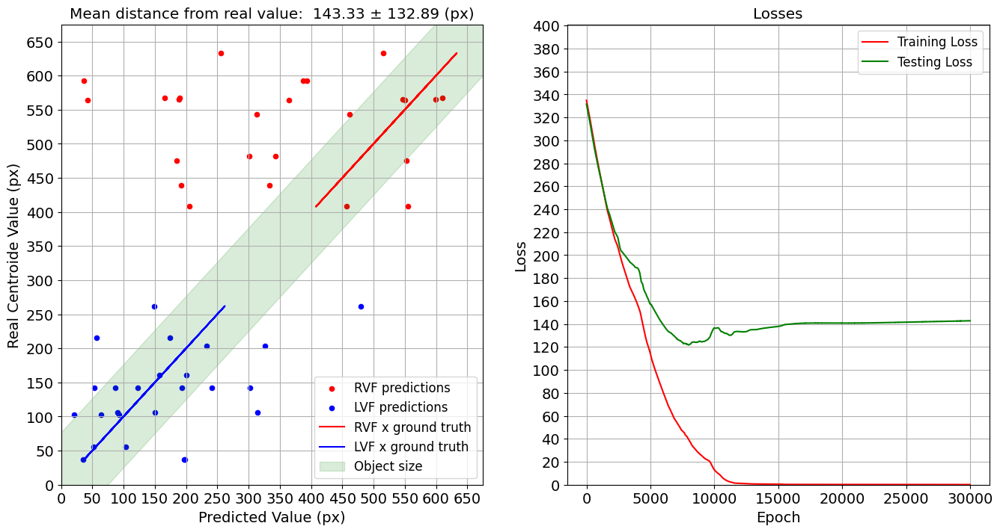

In [ ]:
import math

obj_region = (IM_WIDTH * 2.9)/18.2

fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

x_losses = np.linspace(0, dl_epochs, dl_epochs)

plt.rcParams.update({'font.size': 12})

ax = axs[0]

x_preds = x_preds.reshape(len(x_preds),)

'''
Absolute error: |True value - Measured Value|
Relative error: |Absolute error / True value|
Percent  error: Relative error * 100
'''
rel_error = (np.abs(real_x - x_preds)/real_x)*100
distance = np.abs(real_x - x_preds)

RVF_real_x = [x for x in range(len(real_x)) if real_x[x] > IM_WIDTH/2]
LVF_real_x = [x for x in range(len(real_x)) if real_x[x] < IM_WIDTH/2]

# Scatter plots on the same axes
ax.scatter(x_preds[RVF_real_x], real_x[RVF_real_x], color='r', label='RVF predictions',alpha=1, s=20);
ax.scatter(x_preds[LVF_real_x], real_x[LVF_real_x], color='b', label='LVF predictions',alpha=1, s=20);

plus_minus_symbol = chr(0x00B1)
ax.set(xlabel='Predicted Value (px)', 
    xticks=np.arange(0, IM_WIDTH + 3, step = 50),
    xlim=(0, IM_WIDTH + 3),
    ylabel='Real Centroide Value (px)',
    yticks=np.arange(0, IM_WIDTH + 3, step = 50),
    ylim=(0, IM_WIDTH + 3),
    title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
ax.grid(True)

ax.plot(real_x[RVF_real_x], real_x[RVF_real_x], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
ax.plot(real_x[LVF_real_x], real_x[LVF_real_x], 'b', alpha=1, label = 'LVF x ground truth') 
#ax.scatter(real_x[RVF_real_x], real_x[RVF_real_x], color = (0.9, 0.7, 0), marker = 'X', alpha=0.25, s=60, label = 'RVF x ground truth') # Ground truth plot
#ax.scatter(real_x[LVF_real_x], real_x[LVF_real_x], color = (0, 0.7, 0.9), marker = 'X', alpha=0.25, s=60, label = 'LVF x ground truth') 

diag_rect = patches.Rectangle(
    (min(real_x) - 50, (min(real_x))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                max(real_x) + 400, obj_region, 
                                linewidth=1, edgecolor='g', facecolor='g', alpha=0.15, angle=45, label = 'Object size')
ax.add_patch(diag_rect) # Patch plot

ax.legend()

ax = axs[1]

ax.plot(x_losses, training_losses, 'r', label = 'Training Loss')
ax.plot(x_losses, testing_losses, 'g', label = 'Testing Loss')
ax.set(xlabel='Epoch',
        ylabel='Loss',
        yticks=np.arange(0, 401, step = 20),
        ylim=(0,401),
        title=(f"Losses"));
ax.legend(loc='upper right')
ax.grid(True)
    
plt.subplots_adjust(hspace=0.15)
plt.show()

## Training model (All features)

In [ ]:
# Number of features

train_featVect = np.vstack((NN_featVectRVF[:n_train], NN_featVectLVF[:n_train]))
test_featVect = np.vstack((NN_featVectRVF[n_train:], NN_featVectLVF[n_train:]))

NUM_FEATURES = np.size(train_featVect,1) - 1

# Fit the model
torch.manual_seed(42)
    
# Initializing model

x_pos_model3 = N2pcModel(input_features=NUM_FEATURES, 
                output_features=1, 
                hidden_units=16).to(device)

loss_fn = nn.SmoothL1Loss()
optimizer = torch.optim.Adamax(x_pos_model3.parameters(), 
                        lr=0.002) 

# Shuffle

np.random.seed(42)
np.random.shuffle(train_featVect)
np.random.seed(42)
np.random.shuffle(test_featVect)

# Tensor convertion
tn_train_feat = torch.tensor(np.array(train_featVect[:,0:-1])).type(torch.float32)
tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

tn_test_feat = torch.tensor(np.array(test_featVect[:,0:-1])).type(torch.float32)
tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

# Feature wise normalization of feature vector
n_entries, n_feat = tn_train_feat.size()

for j in range(n_entries):

    mean = tn_train_feat[j,:].mean(dim=0)
    std = tn_train_feat[j,:].std(dim=0)
    tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

n_entries, n_feat = tn_test_feat.size()

for u in range(n_entries):

    mean = tn_test_feat[u,:].mean(dim=0)
    std = tn_test_feat[u,:].std(dim=0)
    tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

training_losses = []
testing_losses = []

for dl_epoch in range(dl_epochs):
    ### Training
    x_pos_model3.train()

    # 1. Forward pass
    x_pos_ = x_pos_model3(tn_train_feat)

    # 2. Calculate loss
    train_loss = loss_fn(torch.squeeze(x_pos_), tn_train_lbl) 
    training_losses.append(train_loss.detach().numpy())
  
    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backwards
    train_loss.backward()

    # 5. Optimizer step
    optimizer.step()

    ### Testing
    x_pos_model3.eval()
    with torch.inference_mode():
      # 1. Forward pass
      output = x_pos_model3(tn_test_feat)
      # 2. Calculate test loss and accuracy
      test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
      testing_losses.append(test_loss.detach().numpy())

    # Print out what's happening
    if (dl_epoch + 1) % 2000 == 0:
        print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

# ------------------------------------ Test ------------------------------------

# 1. Set the model in evaluation mode

x_pos_model3.eval()

# 2. Setup the inference mode context manager
with torch.inference_mode():
  x_preds = x_pos_model3(tn_test_feat)
  
x_preds = x_preds.numpy()
real_x = tn_test_lbl.numpy()

Epoch: 2000 | Training Loss: 273.11108, | Testing Loss: 273.30786
Epoch: 4000 | Training Loss: 220.35419, | Testing Loss: 226.40080
Epoch: 6000 | Training Loss: 184.85023, | Testing Loss: 205.69543
Epoch: 8000 | Training Loss: 140.62823, | Testing Loss: 185.78835
Epoch: 10000 | Training Loss: 98.94579, | Testing Loss: 158.42047
Epoch: 12000 | Training Loss: 65.73168, | Testing Loss: 137.43214
Epoch: 14000 | Training Loss: 40.64310, | Testing Loss: 123.48127
Epoch: 16000 | Training Loss: 27.85857, | Testing Loss: 123.21683
Epoch: 18000 | Training Loss: 12.52246, | Testing Loss: 133.28011


KeyboardInterrupt: 

In [ ]:

'''
from torchviz import make_dot

# Create a dummy input
dummy_input = torch.randn(1,70)  # Replace with appropriate input size

# Generate the computational graph
y = x_pos_model3(dummy_input)
g = make_dot(y, params=dict(list(x_pos_model3.named_parameters())))

# Render the graph to an image file
g.render("model_architecture", format="png")
'''

'\nfrom torchviz import make_dot\n\n# Create a dummy input\ndummy_input = torch.randn(1,70)  # Replace with appropriate input size\n\n# Generate the computational graph\ny = x_pos_model3(dummy_input)\ng = make_dot(y, params=dict(list(x_pos_model3.named_parameters())))\n\n# Render the graph to an image file\ng.render("model_architecture", format="png")\n'

## Ploting predictions against the real values of the object's position alongisde the x-axis (All features)

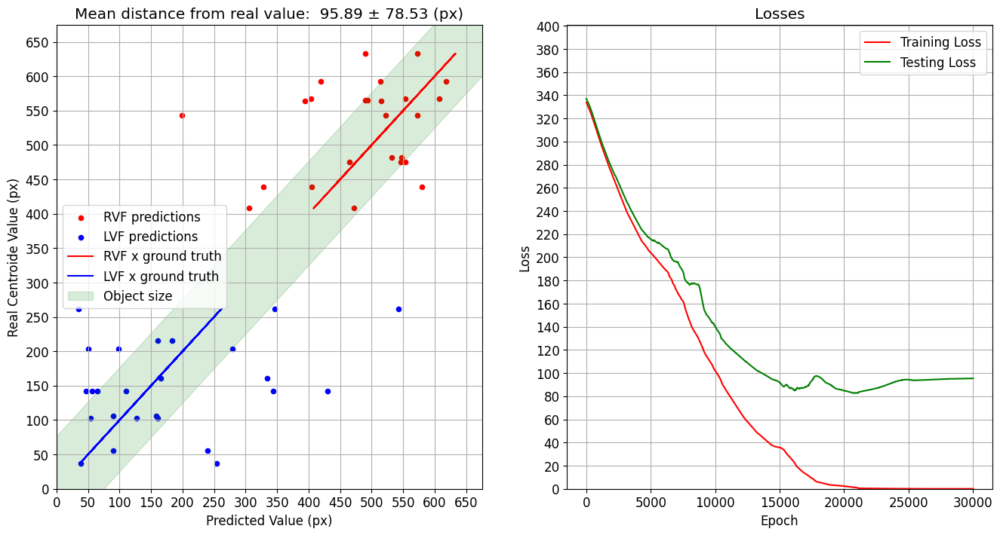

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

x_losses = np.linspace(0, dl_epochs, dl_epochs)

plt.rcParams.update({'font.size': 12})

ax = axs[0]

x_preds = x_preds.reshape(len(x_preds),)

'''
Absolute error: |True value - Measured Value|
Relative error: |Absolute error / True value|
Percent  error: Relative error * 100
'''
rel_error = (np.abs(real_x - x_preds)/real_x)*100
distance = np.abs(real_x - x_preds)

RVF_real_x = [x for x in range(len(real_x)) if real_x[x] > IM_WIDTH/2]
LVF_real_x = [x for x in range(len(real_x)) if real_x[x] < IM_WIDTH/2]

# Scatter plots on the same axes
ax.scatter(x_preds[RVF_real_x], real_x[RVF_real_x], color='r', label='RVF predictions',alpha=1, s=20);
ax.scatter(x_preds[LVF_real_x], real_x[LVF_real_x], color='b', label='LVF predictions',alpha=1, s=20);

plus_minus_symbol = chr(0x00B1)
ax.set(xlabel='Predicted Value (px)', 
    xticks=np.arange(0, IM_WIDTH + 3, step = 50),
    xlim=(0, IM_WIDTH + 3),
    ylabel='Real Centroide Value (px)',
    yticks=np.arange(0, IM_WIDTH + 3, step = 50),
    ylim=(0, IM_WIDTH + 3),
    title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
ax.grid(True)

ax.plot(real_x[RVF_real_x], real_x[RVF_real_x], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
ax.plot(real_x[LVF_real_x], real_x[LVF_real_x], 'b', alpha=1, label = 'LVF x ground truth') 

diag_rect = patches.Rectangle(
    (min(real_x) - 50, (min(real_x))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                max(real_x) + 400, obj_region, 
                                linewidth=1, edgecolor='g', facecolor='g', alpha=0.15, angle=45, label = 'Object size')
ax.add_patch(diag_rect) # Patch plot

ax.legend()

ax = axs[1]

ax.plot(x_losses, training_losses, 'r', label = 'Training Loss')
ax.plot(x_losses, testing_losses, 'g', label = 'Testing Loss')
ax.set(xlabel='Epoch',
        ylabel='Loss',
        yticks=np.arange(0, 401, step = 20),
        ylim=(0,401),
        title=(f"Losses"));
ax.legend(loc='upper right')
ax.grid(True)
    
plt.subplots_adjust(hspace=0.15)
plt.show()

# **Averaging Midline Bilateral - Lateralized Ipsilateral component: N2pcb (200 - 400 ms)**

The mean amplitude of the N2pcb elicited by midline targets was computed as
the subtraction of the ipsilateral activity elicited by lateralized targets from the averaged bilateral activity elicited by
a midline target.

## Grand-Average

In [ ]:
TVF = []
BVF = []

TVF_y_pos = []
BVF_y_pos = []

TVF_target = []
BVF_target = []

for trial in labelled_targets:
    if trial[VERTICAL_CONDITION_COL] == "TVF":
        TVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - aver_ipsi)
        TVF_target.append(trial[DATA_COL])
        TVF_y_pos.append(trial[Y_CENTROID_COL])
    elif trial[VERTICAL_CONDITION_COL] == "BVF":
        BVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - aver_ipsi)
        BVF_target.append(trial[DATA_COL])
        BVF_y_pos.append(trial[Y_CENTROID_COL])

aver_TVF = np.mean(TVF, axis = 0)
aver_BVF = np.mean(BVF, axis = 0)

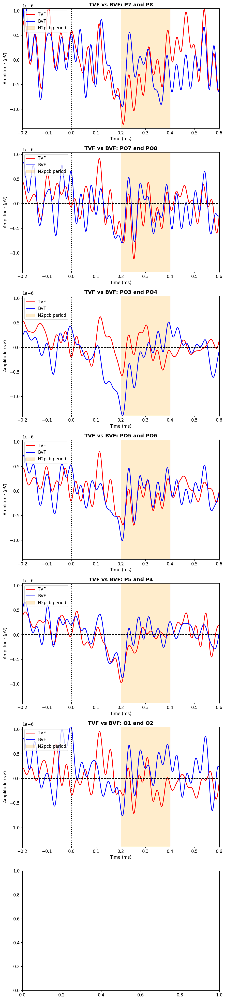

In [ ]:
fig, ax = plt.subplots(figsize=(10, 50), nrows=7, ncols=1)

for i in range(len(left_N2pc_ch_idx)):
    ax[pos[i][0]].plot(ERP_times, aver_TVF[i],'r', label = 'TVF', linewidth = 2)
    ax[pos[i][0]].plot(ERP_times, aver_BVF[i],'b', label = 'BVF', linewidth = 2)
    ax[pos[i][0]].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[pos[i][0]].set_ylim([np.min(aver_BVF),np.max(aver_TVF)])

    N2pcb_region = patches.Rectangle((0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.2, label = "N2pcb period")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[pos[i][0]].add_patch(N2pcb_region)

    ax[pos[i][0]].set_title(f"TVF vs BVF: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[pos[i][0],].set_xlabel('Time (ms)')
    ax[pos[i][0]].set_ylabel('Amplitude ($\mu V$)')
    ax[pos[i][0]].legend(loc='upper left')

    ax[pos[i][0]].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[pos[i][0]].axhline(y=0, color = 'k', linestyle = 'dashed')

plt.show()

## TVF vs BVF Topomaps

Max vlim:  1.5863271247207705e-06
Min vlim:  -5.9287353134113795e-06


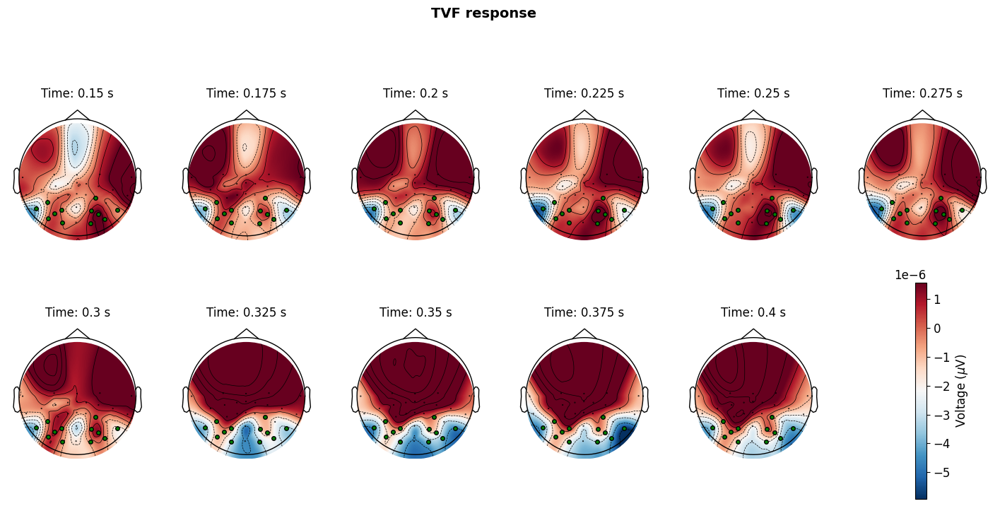

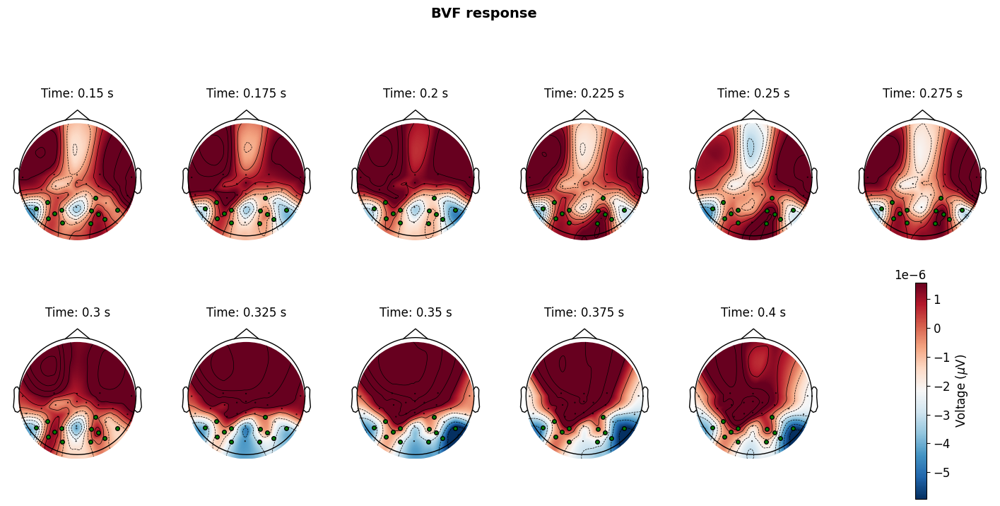

In [ ]:
TVF_ERP = np.mean(TVF_target, axis = 0)
BVF_ERP = np.mean(BVF_target, axis = 0)

t_win = 0.005

t_intervals = [0.15,
               0.175,
               0.2,
               0.225, 
               0.25, 
               0.275, 
               0.3, 
               0.325, 
               0.35, 
               0.375,
               0.40,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(BVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(TVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("TVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(TVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01) 
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("BVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(BVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

## Calculate the single-trial N2pcb component

In [ ]:
n_trials,  _, _ = np.shape(TVF)

featVectTVF = []
featVectBVF = []

NN_featVectTVF = []
NN_featVectBVF = []

ts = 0.2
te = 0.4

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

for trial in range(n_trials):

    res_TVF = resample(TVF[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    res_BVF = resample(BVF[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            auxTVF = np.hstack((res_TVF[c-1,:],res_TVF[c,:]))
            auxBVF = np.hstack((res_BVF[c-1,:],res_BVF[c,:]))
        else:
            auxTVF = np.hstack((auxTVF,res_TVF[c,:]))
            auxBVF = np.hstack((auxBVF,res_BVF[c,:]))
    
    '''
    if(trial >= 0 and trial <= 30):
        plt.plot(res_TVF[0], "b:", label = "TVF")
        plt.plot(res_BVF[0], "r", label = "BVF")
        plt.legend()
        plt.show()
    '''

    featVectTVF.append(np.hstack((auxTVF, 0)))
    featVectBVF.append(np.hstack((auxBVF, 1)))

    NN_featVectTVF.append(np.hstack((auxTVF, TVF_y_pos[trial])))
    NN_featVectBVF.append(np.hstack((auxBVF, BVF_y_pos[trial])))

print(np.shape(featVectTVF))
print(np.shape(featVectBVF))

(100, 85)
(100, 85)


# **Classifying N2pcb: TVF vs BVF**

## Train/Test Split and concatenate feature vectors for all channel differences

In [ ]:
n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

train_featVect = np.vstack((featVectTVF[:n_train], featVectBVF[:n_train]))
test_featVect = np.vstack((featVectTVF[n_train:], featVectBVF[n_train:]))

random.seed(42)
np.random.shuffle(train_featVect)
random.seed(42)
np.random.shuffle(test_featVect)

### Row-wise normalization of the feature vector

In [ ]:
# Feature wise normalization of feature vector
n_entries = np.size(train_featVect, 0)

norm_train_featVect = []

for j in range(n_entries):

    mean = np.mean(train_featVect[j, 0:-1])
    std = np.std(train_featVect[j, 0:-1])
    norm_train_featVect.append(np.hstack(((train_featVect[j,0:-1] - mean) / std, train_featVect[j, -1])))

n_entries = np.size(test_featVect, 0)

norm_test_featVect = []

for u in range(n_entries):

    mean = np.mean(test_featVect[u,0:-1])
    std = np.std(test_featVect[u,0:-1])
    norm_test_featVect.append(np.hstack(((test_featVect[u,0:-1] - mean) / std, test_featVect[u, -1])))

train_featVect = np.array(norm_train_featVect)
test_featVect = np.array(norm_test_featVect)

# Mutual Based Information

In [ ]:
best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(train_featVect[:,0:-1], train_featVect[:,-1]).get_support()
best_feat_idx = np.append(best_feat_idx, False)

### Selecting the most relevant channel for classification

In [ ]:
tf = np.zeros(n_ch)
cont = np.ones(N_DATAPOINTS_RESA_FREQ)

for i in range(n_ch):
    tf[i] = (np.sum(cont[best_feat_idx[i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

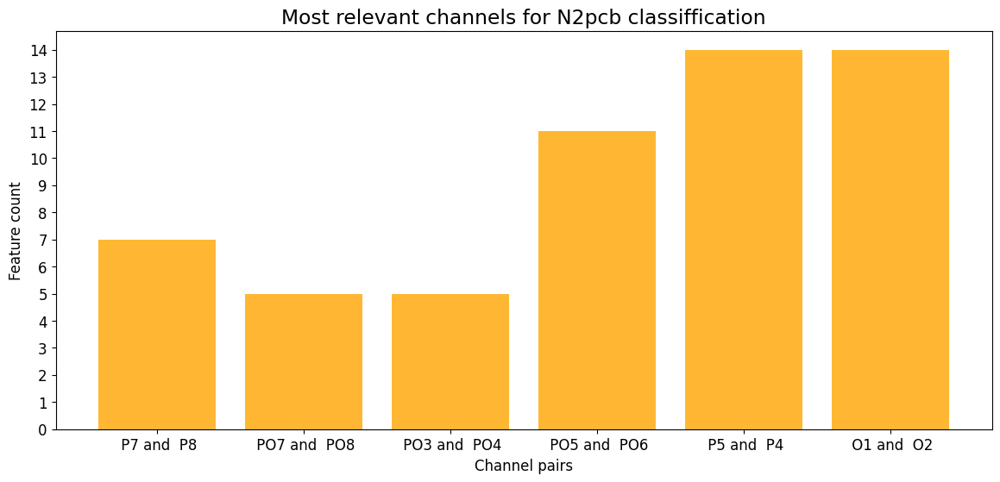

In [ ]:
customlb = []
for c, lb in enumerate(left_N2pc_channels):
    customlb.append(str(lb) + " and " + str(right_N2pc_channels[c]))

fig, ax = plt.subplots(figsize=(14, 6))
plt.rcParams.update({'font.size': 14})
ax.set_title(f'Most relevant channels for N2pcb classiffication')
ax.bar(np.arange(1, n_ch + 1), tf, color="orange", capsize=4, alpha = 0.8)
ax.set(xticks=np.arange(1, n_ch + 1), 
       xlabel='Channel pairs', 
       yticks=np.arange(0, max(tf) + 1, step=1),
       ylabel = "Feature count")
ax.set_xticklabels(customlb);

plt.show()

### Selecting the most relevant channel for classification

In [ ]:
best_channel_feat_idx = np.zeros(len(best_feat_idx))

for i in range(len(tf)):
    if(tf[i] >=  sorted(tf, reverse = True)[2]):
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
    else:
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean
best_channel_feat_idx

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False])

## Classification models

### Most discriminative channels

In [ ]:
print("========================== Most discriminative channels ==========================\n")

# SVM
kernel = 'sigmoid'
clf16 = SVC(kernel=kernel, probability=True)
scores = cross_val_score(clf16, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf16.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf16.predict(test_featVect[:, best_channel_feat_idx])
print("------------- SVM -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf16.predict_proba(test_featVect[:,best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# LDA
clf17 = LDA(solver = solver)
scores = cross_val_score(clf17, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf17.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf17.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- LDA -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf17.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Random Forest
clf18 = RandomForestClassifier()  # Create an instance of Random Forest classifier
scores = cross_val_score(clf18, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf18.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf18.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- Random Forest -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf18.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf19 = xgb.XGBClassifier(learning_rate = 0.05)  # Create an instance of XGBoost classifier
scores = cross_val_score(clf19, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf19.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf19.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- XGBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf19.predict_proba(test_featVect[:,best_channel_feat_idx])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf20 = AdaBoostClassifier(learning_rate = 0.05)  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf20, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf20.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf20.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- AdaBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf20.predict_proba(test_featVect[:, best_channel_feat_idx])[:,1]),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== Most discriminative channels ==========================

------------- SVM -------------
AUC:  0.6
Cross validation mean score: 0.51 +/- 0.09
Accuracy:  0.44

------------- LDA -------------
AUC:  0.56
Cross validation mean score: 0.55 +/- 0.09
Accuracy:  0.52



------------- Random Forest -------------
AUC:  0.4
Cross validation mean score: 0.51 +/- 0.09
Accuracy:  0.42

------------- XGBoost -------------
AUC:  0.46
Cross validation mean score: 0.63 +/- 0.09
Accuracy:  0.46


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost -------------
AUC:  0.44
Cross validation mean score: 0.6 +/- 0.1
Accuracy:  0.48


### All features

In [ ]:
print("========================== All features ==========================\n")

# SVM
kernel = 'rbf'
clf26 = SVC(kernel=kernel, probability=True)
scores = cross_val_score(clf26, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf26.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf26.predict(test_featVect[:, 0:-1])
print("------------- SVM -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf26.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# LDA
clf27 = LDA(solver = solver, shrinkage = 0.001)
scores = cross_val_score(clf27, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf27.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf27.predict(test_featVect[:, 0:-1])
print("\n------------- LDA -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf27.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Random Forest
clf28 = RandomForestClassifier()  # Create an instance of Random Forest classifier
scores = cross_val_score(clf28, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf28.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf28.predict(test_featVect[:, 0:-1])
print("\n------------- Random Forest -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf28.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf29 = xgb.XGBClassifier(learning_rate = 0.05)  # Create an instance of XGBoost classifier
scores = cross_val_score(clf29, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf29.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf29.predict(test_featVect[:, 0:-1])
print("\n------------- XGBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf29.predict_proba(test_featVect[:, 0:-1])[:,1]),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf30 = AdaBoostClassifier(learning_rate = 0.05)  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf30, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf30.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf30.predict(test_featVect[:, 0:-1])
print("\n------------- AdaBoost -------------")
print("AUC: ", round(roc_auc_score(test_featVect[:, -1], clf30.predict_proba(test_featVect[:, 0:-1])[:,1]),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== All features ==========================

------------- SVM -------------
AUC:  0.53
Cross validation mean score: 0.57 +/- 0.1
Accuracy:  0.52

------------- LDA -------------
AUC:  0.7
Cross validation mean score: 0.54 +/- 0.1
Accuracy:  0.66

------------- Random Forest -------------
AUC:  0.57
Cross validation mean score: 0.57 +/- 0.15
Accuracy:  0.54

------------- XGBoost -------------
AUC:  0.6
Cross validation mean score: 0.6 +/- 0.15
Accuracy:  0.54


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost -------------
AUC:  0.64
Cross validation mean score: 0.56 +/- 0.13
Accuracy:  0.66


## NN model

In [ ]:
torch.manual_seed(42)

class N2pcbModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

## Training model (Most discriminative channels)

In [ ]:
# Number of features

train_featVect = np.vstack((NN_featVectTVF[:n_train], NN_featVectBVF[:n_train]))
test_featVect = np.vstack((NN_featVectTVF[n_train:], NN_featVectBVF[n_train:]))

NUM_FEATURES = np.size(train_featVect[:, best_channel_feat_idx],1)

# Fit the model
torch.manual_seed(42)
    
# Initializing model

y_pos_model1 = N2pcbModel(input_features=NUM_FEATURES, 
                output_features=1, 
                hidden_units=16).to(device)

loss_fn = nn.SmoothL1Loss()
optimizer = torch.optim.Adamax(y_pos_model1.parameters(), 
                        lr=0.005) 

# Shuffle

np.random.seed(42)
np.random.shuffle(train_featVect)
np.random.seed(42)
np.random.shuffle(test_featVect)

# Tensor convertion
tn_train_feat = torch.tensor(np.array(train_featVect[:, best_channel_feat_idx])).type(torch.float32)
tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

tn_test_feat = torch.tensor(np.array(test_featVect[:, best_channel_feat_idx])).type(torch.float32)
tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

# Feature wise normalization of feature vector
n_entries, n_feat = tn_train_feat.size()

for j in range(n_entries):

    mean = tn_train_feat[j,:].mean(dim=0)
    std = tn_train_feat[j,:].std(dim=0)
    tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

n_entries, n_feat = tn_test_feat.size()

for u in range(n_entries):

    mean = tn_test_feat[u,:].mean(dim=0)
    std = tn_test_feat[u,:].std(dim=0)
    tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

training_losses = []
testing_losses = []

for dl_epoch in range(dl_epochs):
    ### Training
    y_pos_model1.train()

    # 1. Forward pass
    y_pos_ = y_pos_model1(tn_train_feat)

    # 2. Calculate loss
    train_loss = loss_fn(torch.squeeze(y_pos_), tn_train_lbl) 
    training_losses.append(train_loss.detach().numpy())
  
    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backwards
    train_loss.backward()

    # 5. Optimizer step
    optimizer.step()

    ### Testing
    y_pos_model1.eval()
    with torch.inference_mode():
      # 1. Forward pass
      output = y_pos_model1(tn_test_feat)
      # 2. Calculate test loss and accuracy
      test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
      testing_losses.append(test_loss.detach().numpy())

    # Print out what's happening
    if (dl_epoch + 1) % 2000 == 0:
        print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

# ------------------------------------ Test ------------------------------------

# 1. Set the model in evaluation mode

y_pos_model1.eval()

# 2. Setup the inference mode context manager
with torch.inference_mode():
  y_preds = y_pos_model1(tn_test_feat)
  
y_preds = y_preds.numpy()
real_y = tn_test_lbl.numpy()

Epoch: 2000 | Training Loss: 142.84901, | Testing Loss: 153.20062
Epoch: 4000 | Training Loss: 106.09782, | Testing Loss: 150.40198


KeyboardInterrupt: 

## Ploting predictions against the real values of the object's position alongisde the y-axis (Most discriminative channels)

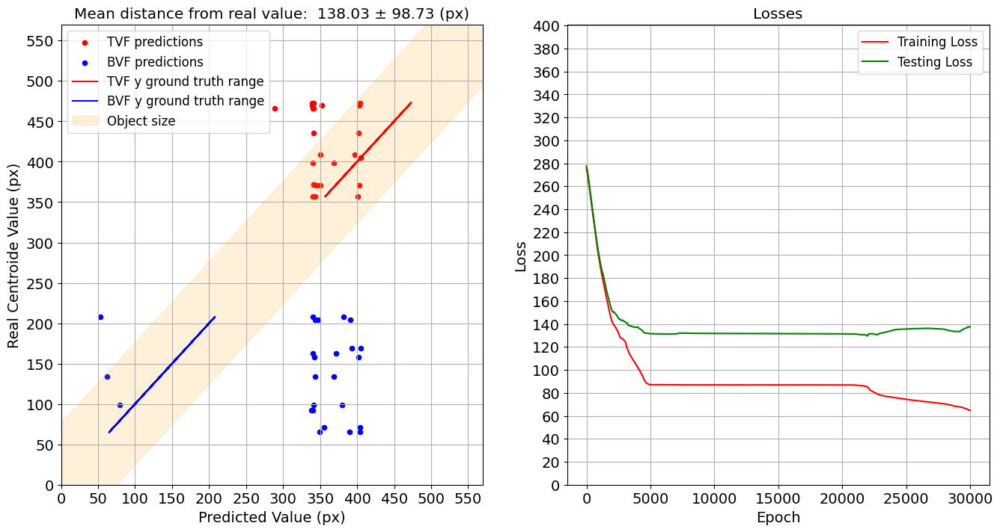

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

y_losses = np.linspace(0, dl_epochs, dl_epochs)

plt.rcParams.update({'font.size': 12})

ax = axs[0]

y_preds = y_preds.reshape(len(y_preds),)

'''
Absolute error: |True value - Measured Value|
Relative error: |Absolute error / True value|
Percent  error: Relative error * 100
'''
rel_error = (np.abs(real_y - y_preds)/real_y)*100
distance = np.abs(real_y - y_preds)

TVF_real_y = [y for y in range(len(real_y)) if real_y[y] > IM_HEIGHT/2]
BVF_real_y = [y for y in range(len(real_y)) if real_y[y] < IM_HEIGHT/2]

# Scatter plots on the same axes
ax.scatter(y_preds[TVF_real_y], real_y[TVF_real_y], color='r', label='TVF predictions',alpha=1, s=20);
ax.scatter(y_preds[BVF_real_y], real_y[BVF_real_y], color='b', label='BVF predictions',alpha=1, s=20);

plus_minus_symbol = chr(0x00B1)
ax.set(xlabel='Predicted Value (px)', 
    xticks=np.arange(0, IM_HEIGHT + 3, step = 50),
    xlim=(0, IM_HEIGHT + 3),
    ylabel='Real Centroide Value (px)',
    yticks=np.arange(0, IM_HEIGHT + 3, step = 50),
    ylim=(0, IM_HEIGHT + 3),
    title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
ax.grid(True)

ax.plot(real_y[TVF_real_y], real_y[TVF_real_y], 'r', alpha=1, label = 'TVF y ground truth range') # Line plot
ax.plot(real_y[BVF_real_y], real_y[BVF_real_y], 'b', alpha=1, label = 'BVF y ground truth range') 

diag_rect = patches.Rectangle(
    (min(real_y) - 50, (min(real_y))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                max(real_y) + 400, obj_region, 
                                linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, angle=45, label = 'Object size')
ax.add_patch(diag_rect) # Patch plot

ax.legend()

ax = axs[1]

ax.plot(y_losses, training_losses, 'r', label = 'Training Loss')
ax.plot(y_losses, testing_losses, 'g', label = 'Testing Loss')
ax.set(xlabel='Epoch',
        ylabel='Loss',
        yticks=np.arange(0, 401, step = 20),
        ylim=(0,401),
        title=(f"Losses"));
ax.legend(loc='upper right')
ax.grid(True)
    
plt.subplots_adjust(hspace=0.15)
plt.show()

## Training model (All features)

In [ ]:
# Number of features

train_featVect = np.vstack((NN_featVectTVF[:n_train], NN_featVectBVF[:n_train]))
test_featVect = np.vstack((NN_featVectTVF[n_train:], NN_featVectBVF[n_train:]))

NUM_FEATURES = np.size(train_featVect[:, 0:-1], 1)

# Fit the model
torch.manual_seed(42)
    
# Initializing model

y_pos_model3 = N2pcbModel(input_features=NUM_FEATURES, 
                output_features=1, 
                hidden_units=16).to(device)

loss_fn = nn.SmoothL1Loss()
optimizer = torch.optim.Adamax(y_pos_model3.parameters(), 
                        lr=0.005) 

# Shuffle

np.random.seed(42)
np.random.shuffle(train_featVect)
np.random.seed(42)
np.random.shuffle(test_featVect)

# Tensor convertion
tn_train_feat = torch.tensor(np.array(train_featVect[:, 0:-1])).type(torch.float32)
tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

tn_test_feat = torch.tensor(np.array(test_featVect[:, 0:-1])).type(torch.float32)
tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

# Feature wise normalization of feature vector
n_entries, n_feat = tn_train_feat.size()

for j in range(n_entries):

    mean = tn_train_feat[j,:].mean(dim=0)
    std = tn_train_feat[j,:].std(dim=0)
    tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

n_entries, n_feat = tn_test_feat.size()

for u in range(n_entries):

    mean = tn_test_feat[u,:].mean(dim=0)
    std = tn_test_feat[u,:].std(dim=0)
    tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

training_losses = []
testing_losses = []

for dl_epoch in range(dl_epochs):
    ### Training
    y_pos_model3.train()

    # 1. Forward pass
    y_pos_ = y_pos_model3(tn_train_feat)

    # 2. Calculate loss
    train_loss = loss_fn(torch.squeeze(y_pos_), tn_train_lbl) 
    training_losses.append(train_loss.detach().numpy())
  
    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backwards
    train_loss.backward()

    # 5. Optimizer step
    optimizer.step()

    ### Testing
    y_pos_model3.eval()
    with torch.inference_mode():
      # 1. Forward pass
      output = y_pos_model3(tn_test_feat)
      # 2. Calculate test loss and accuracy
      test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
      testing_losses.append(test_loss.detach().numpy())

    # Print out what's happening
    if (dl_epoch + 1) % 2000 == 0:
        print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

# ------------------------------------ Test ------------------------------------

# 1. Set the model in evaluation mode

y_pos_model3.eval()

# 2. Setup the inference mode context manager
with torch.inference_mode():
  y_preds = y_pos_model3(tn_test_feat)
  
y_preds = y_preds.numpy()
real_y = tn_test_lbl.numpy()

Epoch: 2000 | Training Loss: 141.07401, | Testing Loss: 150.13193
Epoch: 4000 | Training Loss: 98.92200, | Testing Loss: 132.93469
Epoch: 6000 | Training Loss: 80.82055, | Testing Loss: 130.24014
Epoch: 8000 | Training Loss: 5.45083, | Testing Loss: 127.24033
Epoch: 10000 | Training Loss: 0.89110, | Testing Loss: 134.50569


KeyboardInterrupt: 

## Ploting predictions against the real values of the object's position alongisde the y-axis (All features)

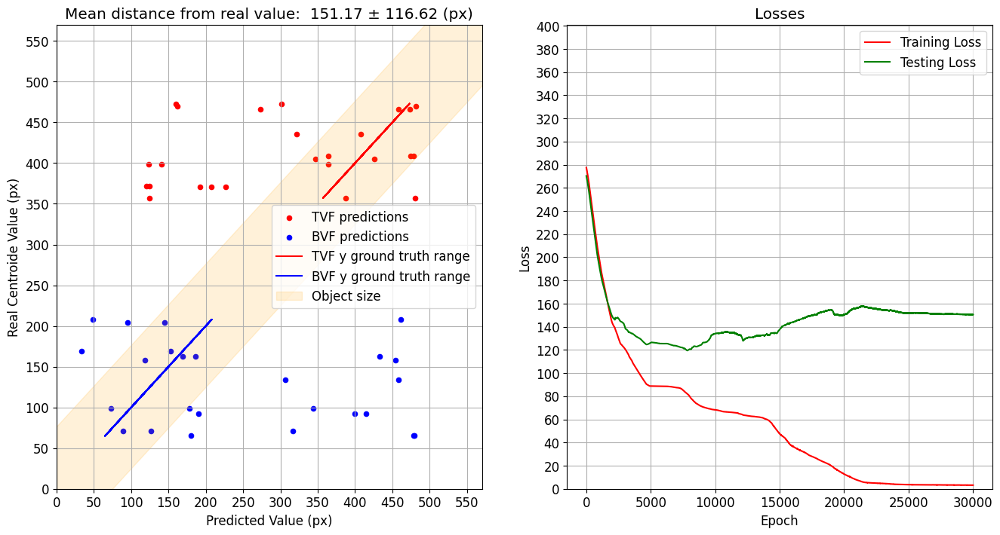

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

y_losses = np.linspace(0, dl_epochs, dl_epochs)

plt.rcParams.update({'font.size': 12})

ax = axs[0]

y_preds = y_preds.reshape(len(y_preds),)

'''
Absolute error: |True value - Measured Value|
Relative error: |Absolute error / True value|
Percent  error: Relative error * 100
'''
rel_error = (np.abs(real_y - y_preds)/real_y)*100
distance = np.abs(real_y - y_preds)

TVF_real_y = [y for y in range(len(real_y)) if real_y[y] > IM_HEIGHT/2]
BVF_real_y = [y for y in range(len(real_y)) if real_y[y] < IM_HEIGHT/2]

# Scatter plots on the same axes
ax.scatter(y_preds[TVF_real_y], real_y[TVF_real_y], color='r', label='TVF predictions',alpha=1, s=20);
ax.scatter(y_preds[BVF_real_y], real_y[BVF_real_y], color='b', label='BVF predictions',alpha=1, s=20);

plus_minus_symbol = chr(0x00B1)
ax.set(xlabel='Predicted Value (px)', 
    xticks=np.arange(0, IM_HEIGHT + 3, step = 50),
    xlim=(0, IM_HEIGHT + 3),
    ylabel='Real Centroide Value (px)',
    yticks=np.arange(0, IM_HEIGHT + 3, step = 50),
    ylim=(0, IM_HEIGHT + 3),
    title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
ax.grid(True)

ax.plot(real_y[TVF_real_y], real_y[TVF_real_y], 'r', alpha=1, label = 'TVF y ground truth range') # Line plot
ax.plot(real_y[BVF_real_y], real_y[BVF_real_y], 'b', alpha=1, label = 'BVF y ground truth range') 

diag_rect = patches.Rectangle(
    (min(real_y) - 50, (min(real_y))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                max(real_y) + 400, obj_region, 
                                linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, angle=45, label = 'Object size')
ax.add_patch(diag_rect) # Patch plot

ax.legend()

ax = axs[1]

ax.plot(y_losses, training_losses, 'r', label = 'Training Loss')
ax.plot(y_losses, testing_losses, 'g', label = 'Testing Loss')
ax.set(xlabel='Epoch',
        ylabel='Loss',
        yticks=np.arange(0, 401, step = 20),
        ylim=(0,401),
        title=(f"Losses"));
ax.legend(loc='upper right')
ax.grid(True)
    
plt.subplots_adjust(hspace=0.15)
plt.show()

# Signal analysis and Classification based on 4 quadrants: (RVF and TBF; RVF and TBF; LVF and TBF; LVF and TBF)

## Calculating the single trial N2pc for each quadrant

In [ ]:

RVF_TVF_contralateral = []
RVF_TVF_ipsilateral = []

RVF_BVF_contralateral = []
RVF_BVF_ipsilateral = []

LVF_TVF_contralateral = []
LVF_TVF_ipsilateral = []

LVF_BVF_contralateral = []
LVF_BVF_ipsilateral = []

RVF_TVF_target = []
RVF_BVF_target = []
LVF_TVF_target = []
LVF_BVF_target = []

RVF_TVF_xy_pos = []
RVF_BVF_xy_pos = []
LVF_TVF_xy_pos = []
LVF_BVF_xy_pos = []

for trial in labelled_targets:
    if(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):
        RVF_TVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
        RVF_TVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

        RVF_TVF_target.append(trial[DATA_COL])

        RVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

    elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):
        RVF_BVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
        RVF_BVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

        RVF_BVF_target.append(trial[DATA_COL])

        RVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

    elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):
        LVF_TVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
        LVF_TVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

        LVF_TVF_target.append(trial[DATA_COL])

        LVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

    elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):
        LVF_BVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
        LVF_BVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
        
        LVF_BVF_target.append(trial[DATA_COL])

        LVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

print("Nº RVF | TVF: ", np.size(RVF_TVF_target, 0))
print("Nº RVF | BVF: ", np.size(RVF_BVF_target, 0))
print("Nº LVF | TVF: ", np.size(LVF_TVF_target, 0))
print("Nº LVF | BVF: ", np.size(LVF_BVF_target, 0))

Nº RVF | TVF:  40
Nº RVF | BVF:  40
Nº LVF | TVF:  40
Nº LVF | BVF:  40


## Grand-Averages

In [ ]:
RVF_TVF_aver = np.mean(RVF_TVF_contralateral, axis = 0) - np.mean(RVF_TVF_ipsilateral, axis = 0)
RVF_BVF_aver = np.mean(RVF_BVF_contralateral, axis = 0) - np.mean(RVF_BVF_ipsilateral, axis = 0)
LVF_TVF_aver = np.mean(LVF_TVF_contralateral, axis = 0) - np.mean(LVF_TVF_ipsilateral, axis = 0)
LVF_BVF_aver = np.mean(LVF_BVF_contralateral, axis = 0) - np.mean(LVF_BVF_ipsilateral, axis = 0)

RVF_TVF_erp = np.mean(RVF_TVF_target, axis = 0)
RVF_BVF_erp = np.mean(RVF_BVF_target, axis = 0)
LVF_TVF_erp = np.mean(LVF_TVF_target, axis = 0)
LVF_BVF_erp = np.mean(LVF_BVF_target, axis = 0)

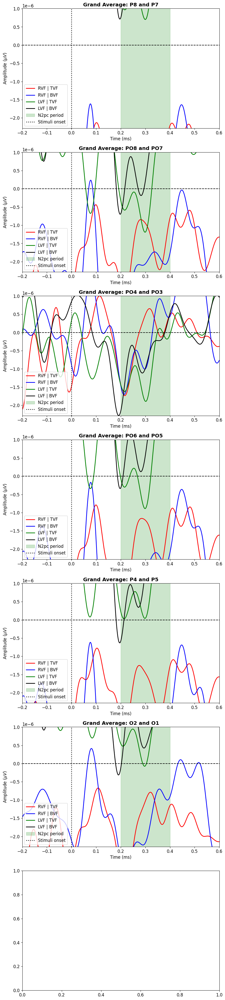

In [ ]:
fig, ax = plt.subplots(figsize=(10, 50), nrows=7, ncols=1)

for i in range(len(left_N2pc_ch_idx)):

    ax[pos[i][0]].plot(ERP_times, RVF_TVF_aver[i],'r', label = 'RVF | TVF', linewidth = 2)
    ax[pos[i][0]].plot(ERP_times, RVF_BVF_aver[i],'b', label = 'RVF | BVF', linewidth = 2)
    ax[pos[i][0]].plot(ERP_times, LVF_TVF_aver[i],'g', label = 'LVF | TVF', linewidth = 2)
    ax[pos[i][0]].plot(ERP_times, LVF_BVF_aver[i],'k', label = 'LVF | BVF', linewidth = 2)

    ax[pos[i][0]].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[pos[i][0]].set_ylim([np.min(LVF_BVF_aver),np.max(RVF_TVF_aver)])

    N2pc_region = patches.Rectangle((0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[pos[i][0]].add_patch(N2pc_region)

    ax[pos[i][0]].set_title(f"Grand Average: {clean_ch[right_N2pc_ch_idx[i]]} and {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[pos[i][0]].set_xlabel('Time (ms)')
    ax[pos[i][0]].set_ylabel('Amplitude ($\mu V$)')

    ax[pos[i][0]].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[pos[i][0]].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[pos[i][0]].legend(loc='lower left')

    #ax[pos[i][0],pos[i][1]].invert_yaxis()

plt.show()

Max vlim:  8.312192658865567e-06
Min vlim:  -5.004772140158337e-06


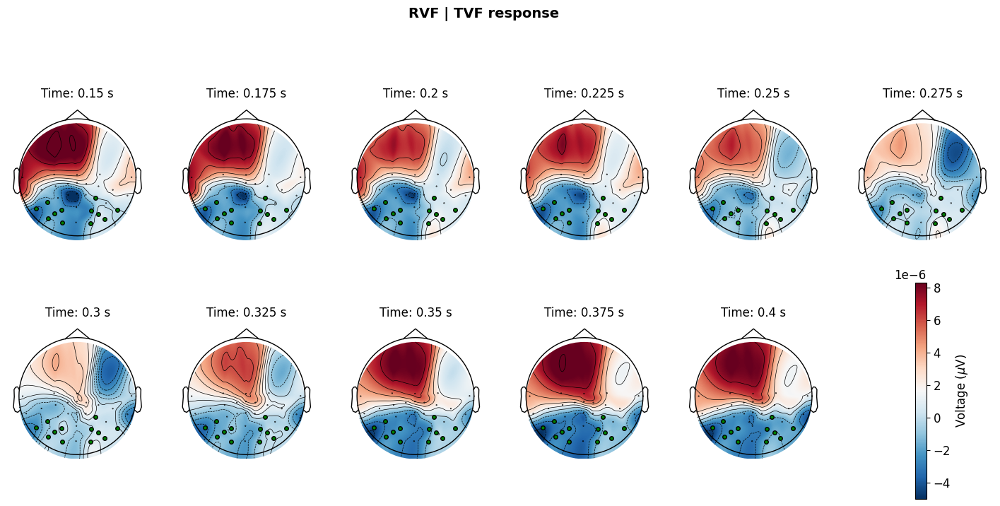

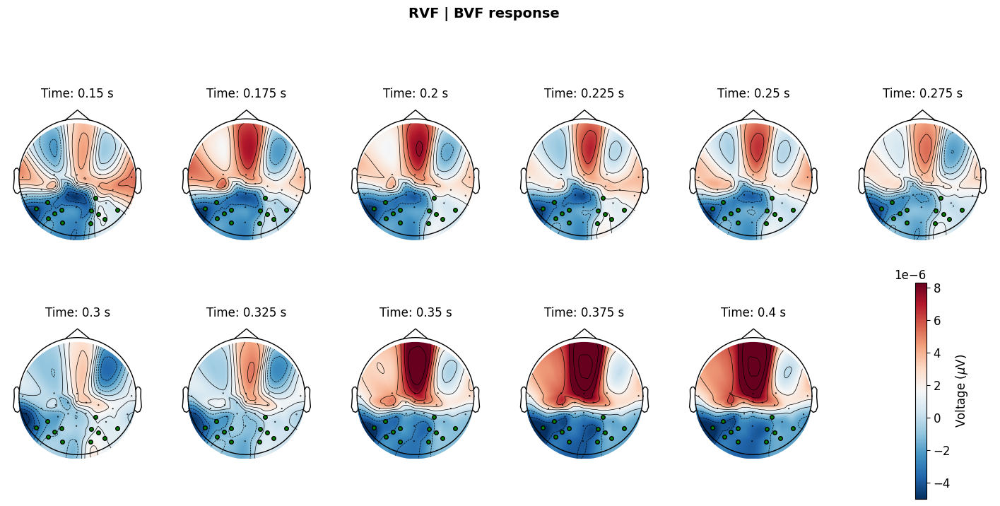

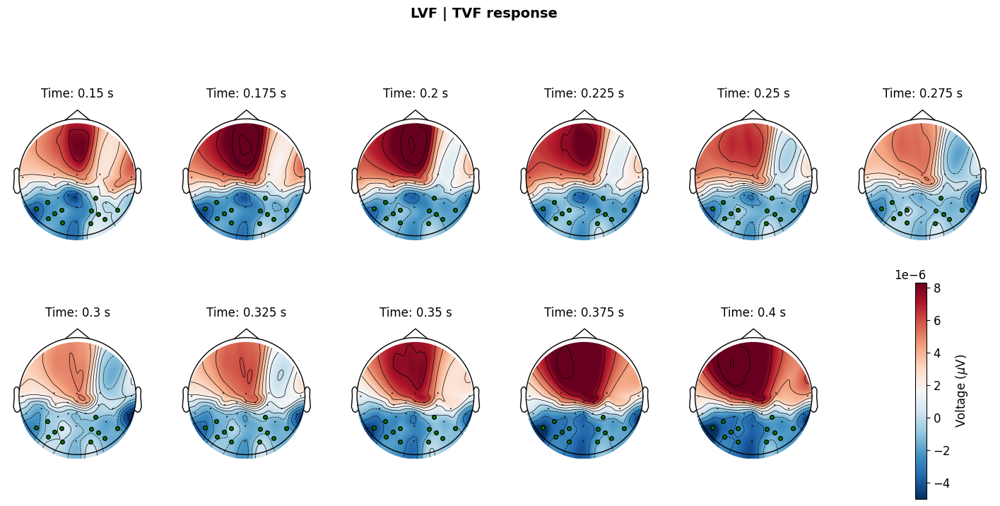

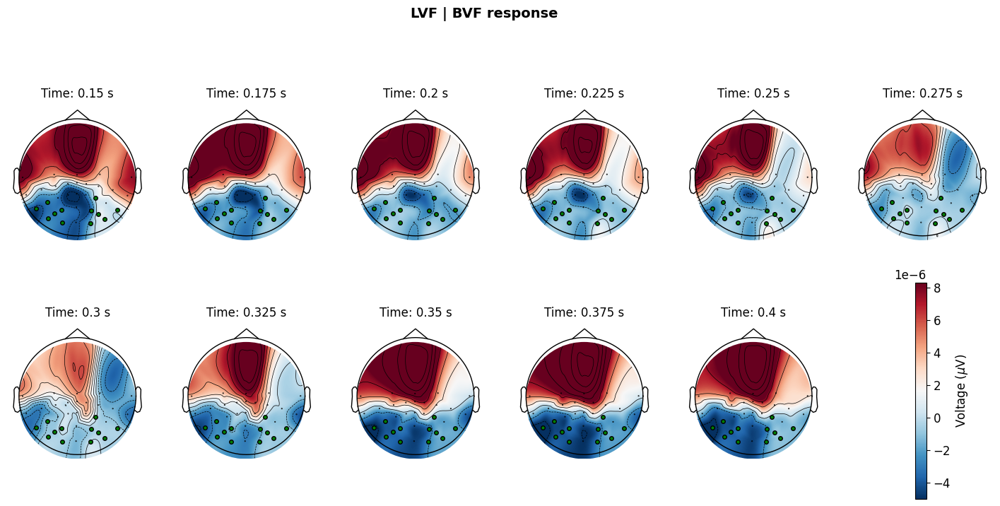

In [ ]:
vmap_max = np.max(LVF_TVF_erp[:,t_sample_start:t_sample_stop])
vmap_min = np.min(LVF_TVF_erp[:,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

t_win = 0.005

t_intervals = [0.15,
               0.175,
               0.2,
               0.225, 
               0.25, 
               0.275, 
               0.3, 
               0.325, 
               0.35, 
               0.375,
               0.40,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

# ------------------------------------------------------ RVF | TVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("RVF | TVF response", fontweight = 'bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_TVF_erp[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01) 
plt.show()

# ------------------------------------------------------ RVF | BVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("RVF | BVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_BVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

# ------------------------------------------------------ LVF | TVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("LVF | TVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_TVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

# ------------------------------------------------------ LVF | BVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("LVF | BVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_BVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            eeg_smearing.info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

## Handling the feature vectors

In [ ]:
featVectRVF_TVF = [] # Class label = 0
featVectRVF_BVF = [] # Class label = 1
featVectLVF_TVF = [] # Class label = 2
featVectLVF_BVF = [] # Class label = 3

NN_featVectRVF_TVF = [] 
NN_featVectRVF_BVF = [] 
NN_featVectLVF_TVF = [] 
NN_featVectLVF_BVF = [] 

ts = 0.1
te = 0.3

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

# ------------------------------------------------------ RVF | TVF ------------------------------------------------------

for trial in range(np.size(RVF_TVF_contralateral, 0)):

    RVF_TVF = resample(RVF_TVF_contralateral[trial][:,idx_s:idx_e+1] - RVF_TVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            auxRVF_TVF = np.hstack((RVF_TVF[c-1,:],RVF_TVF[c,:]))
        else:
            auxRVF_TVF = np.hstack((auxRVF_TVF,RVF_TVF[c,:]))

    featVectRVF_TVF.append(np.hstack((auxRVF_TVF, 0)))
    NN_featVectRVF_TVF.append(np.hstack((auxRVF, RVF_TVF_xy_pos[trial])))

print(np.shape(featVectRVF_TVF))

# ------------------------------------------------------ RVF | BVF ------------------------------------------------------

for trial in range(np.size(RVF_BVF_contralateral, 0)):

    RVF_BVF = resample(RVF_BVF_contralateral[trial][:,idx_s:idx_e+1] - RVF_BVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            auxRVF_BVF = np.hstack((RVF_BVF[c-1,:],RVF_BVF[c,:]))
        else:
            auxRVF_BVF = np.hstack((auxRVF_BVF,RVF_BVF[c,:]))

    featVectRVF_BVF.append(np.hstack((auxRVF_BVF, 1)))
    NN_featVectRVF_BVF.append(np.hstack((auxRVF, RVF_BVF_xy_pos[trial])))

print(np.shape(featVectRVF_BVF))

# ------------------------------------------------------ LVF | TVF ------------------------------------------------------

for trial in range(np.size(LVF_TVF_contralateral, 0)):

    LVF_TVF = resample(LVF_TVF_contralateral[trial][:,idx_s:idx_e+1] - LVF_TVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            auxLVF_TVF = np.hstack((LVF_TVF[c-1,:],LVF_TVF[c,:]))
        else:
            auxLVF_TVF = np.hstack((auxLVF_TVF,LVF_TVF[c,:]))

    featVectLVF_TVF.append(np.hstack((auxLVF_TVF, 2)))
    NN_featVectLVF_TVF.append(np.hstack((auxLVF_TVF, LVF_TVF_xy_pos[trial])))

print(np.shape(featVectLVF_TVF))

# ------------------------------------------------------ LVF | BVF ------------------------------------------------------

for trial in range(np.size(LVF_BVF_contralateral, 0)):

    LVF_BVF = resample(LVF_BVF_contralateral[trial][:,idx_s:idx_e+1] - LVF_BVF_ipsilateral[trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
    
    for c in range(1, n_channels):

        if (c == 1):
            auxLVF_BVF = np.hstack((LVF_BVF[c-1,:],LVF_BVF[c,:]))
        else:
            auxLVF_BVF = np.hstack((auxLVF_BVF,LVF_BVF[c,:]))

    featVectLVF_BVF.append(np.hstack((auxLVF_BVF, 3)))
    NN_featVectLVF_BVF.append(np.hstack((auxLVF_BVF, LVF_BVF_xy_pos[trial])))

print(np.shape(featVectLVF_BVF))

    

(40, 85)
(40, 85)
(40, 85)
(40, 85)


## Train/Test split

In [ ]:
n_train_RVF_TVF = int(np.ceil(len(featVectRVF_TVF) * PERCENT_TRAIN))
n_train_RVF_BVF = int(np.ceil(len(featVectRVF_BVF) * PERCENT_TRAIN))
n_train_LVF_TVF = int(np.ceil(len(featVectLVF_TVF) * PERCENT_TRAIN))
n_train_LVF_BVF = int(np.ceil(len(featVectLVF_BVF) * PERCENT_TRAIN))

train_featVect = np.vstack( (np.vstack( (np.vstack( (featVectRVF_TVF[:n_train_RVF_TVF], featVectRVF_BVF[:n_train_RVF_BVF]) ), featVectLVF_TVF[:n_train_LVF_TVF]) ),  featVectLVF_BVF[:n_train_LVF_BVF]) )
test_featVect = np.vstack( (np.vstack( (np.vstack( (featVectRVF_TVF[n_train_RVF_TVF:], featVectRVF_BVF[n_train_RVF_BVF:]) ), featVectLVF_TVF[n_train_LVF_TVF:]) ),  featVectLVF_BVF[n_train_LVF_BVF:]) )

random.seed(42)
np.random.shuffle(train_featVect)
random.seed(42)
np.random.shuffle(test_featVect)

### Row-wise normalization of the feature vector

In [ ]:
# Feature wise normalization of feature vector
n_entries = np.size(train_featVect, 0)

norm_train_featVect = []

for j in range(n_entries):

    mean = np.mean(train_featVect[j, 0:-1])
    std = np.std(train_featVect[j, 0:-1])
    norm_train_featVect.append(np.hstack(((train_featVect[j,0:-1] - mean) / std, train_featVect[j, -1])))

n_entries = np.size(test_featVect, 0)

norm_test_featVect = []

for u in range(n_entries):

    mean = np.mean(test_featVect[u,0:-1])
    std = np.std(test_featVect[u,0:-1])
    norm_test_featVect.append(np.hstack(((test_featVect[u,0:-1] - mean) / std, test_featVect[u, -1])))

train_featVect = np.array(norm_train_featVect)
test_featVect = np.array(norm_test_featVect)

## Mutual Based Information

In [ ]:
k_feat = N_DATAPOINTS_RESA_FREQ * 3

best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(train_featVect[:,0:-1], train_featVect[:,-1]).get_support()
best_feat_idx = np.append(best_feat_idx, False)

### Distribution of channel importance for classification

In [ ]:
n_ch = len(right_N2pc_ch_idx)

tf = np.zeros(n_ch)
cont = np.ones(N_DATAPOINTS_RESA_FREQ)

for i in range(n_ch):
    tf[i] = (np.sum(cont[best_feat_idx[i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

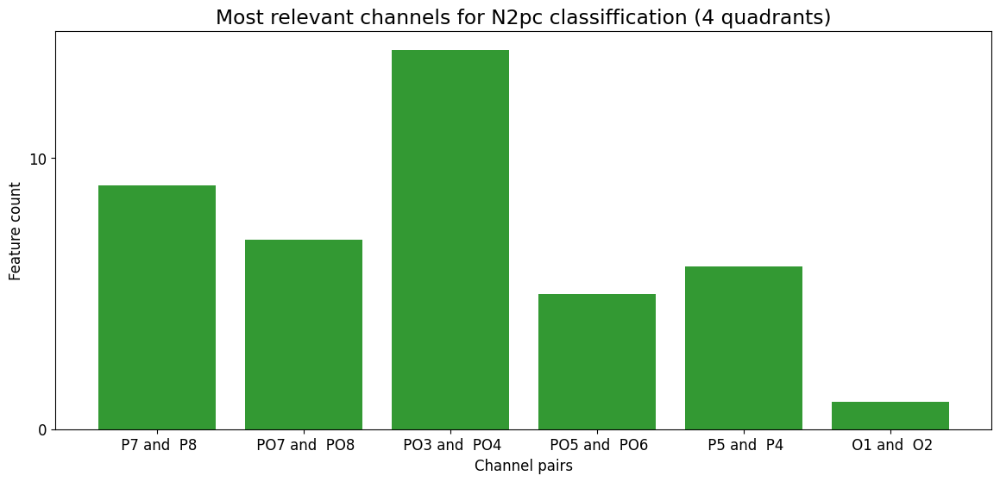

In [ ]:
customlb = []
for c, lb in enumerate(left_N2pc_channels):
    customlb.append(str(lb) + " and " + str(right_N2pc_channels[c]))

fig, ax = plt.subplots(figsize=(14, 6))
plt.rcParams.update({'font.size': 14})
ax.set_title(f'Most relevant channels for N2pc classiffication (4 quadrants)')
ax.bar(np.arange(1, n_ch + 1), tf, color="g", capsize=4, alpha = 0.8)
ax.set(xticks=np.arange(1, n_ch + 1), 
       xlabel='Channel pairs', 
       yticks=np.arange(0, max(tf) + 1, step=10),
       ylabel = "Feature count")
ax.set_xticklabels(customlb);

plt.show();

### Selecting the most relevant channel for classification

In [ ]:
best_channel_feat_idx = np.zeros(len(best_feat_idx))

for i in range(len(tf)):
    if(tf[i] >= sorted(tf, reverse = True)[2]):
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
    else:
        best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean
best_channel_feat_idx

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False])

## Classification (One Versus the Rest) with most discriminative channel selection

In [ ]:
from sklearn.multiclass import OneVsRestClassifier

print("========================== Most discriminative channels ==========================\n")

# SVM
kernel = 'sigmoid'
clf_ovr_svm = OneVsRestClassifier(SVC(kernel=kernel, probability=True))
scores = cross_val_score(clf_ovr_svm, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf_ovr_svm.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred_ovr_svm = clf_ovr_svm.predict(test_featVect[:, best_channel_feat_idx])
print("------------- SVM (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_svm.predict_proba(test_featVect[:, best_channel_feat_idx]), multi_class='ovr'),2))  # Macro averaging for multi-class AUC
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred_ovr_svm),2))

# LDA
solver = 'lsqr'
clf_ovr_lda = OneVsRestClassifier(LDA(solver=solver, shrinkage = 0.001))
scores = cross_val_score(clf_ovr_lda, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf_ovr_lda.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred_ovr_lda = clf_ovr_lda.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- LDA (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_lda.predict_proba(test_featVect[:, best_channel_feat_idx]), multi_class='ovr'),2))  # Macro averaging for multi-class AUC
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred_ovr_lda),2))

# Random Forest
clf_mult_class1 = OneVsRestClassifier(RandomForestClassifier())  # Create an instance of Random Forest classifier
scores = cross_val_score(clf_mult_class1, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf_mult_class1.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf_mult_class1.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- Random Forest (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_mult_class1.predict_proba(test_featVect[:, best_channel_feat_idx]), multi_class='ovr'),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf_mult_class2 = OneVsRestClassifier(xgb.XGBClassifier(learning_rate = 0.01))  # Create an instance of XGBoost classifier
scores = cross_val_score(clf_mult_class2, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf_mult_class2.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf_mult_class2.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- XGBoost (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_mult_class2.predict_proba(test_featVect[:, best_channel_feat_idx]), multi_class = 'ovr'),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf_ovr_adaboost = OneVsRestClassifier(AdaBoostClassifier(learning_rate = 0.01))  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf_ovr_adaboost, train_featVect[:, best_channel_feat_idx], train_featVect[:, -1], cv=kfold)
clf_ovr_adaboost.fit(train_featVect[:, best_channel_feat_idx], train_featVect[:, -1])
pred = clf_ovr_adaboost.predict(test_featVect[:, best_channel_feat_idx])
print("\n------------- AdaBoost (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_adaboost.predict_proba(test_featVect[:, best_channel_feat_idx]), multi_class = 'ovr'),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== Most discriminative channels ==========================



------------- SVM (OvR) -------------
AUC Macro:  0.78
Cross validation mean score: 0.4 +/- 0.09
Accuracy:  0.53

------------- LDA (OvR) -------------
AUC Macro:  0.8
Cross validation mean score: 0.51 +/- 0.09
Accuracy:  0.5

------------- Random Forest (OvR) -------------
AUC Macro:  0.79
Cross validation mean score: 0.46 +/- 0.1
Accuracy:  0.5

------------- XGBoost (OvR) -------------
AUC Macro:  0.77
Cross validation mean score: 0.39 +/- 0.13
Accuracy:  0.5


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost (OvR) -------------
AUC Macro:  0.72
Cross validation mean score: 0.38 +/- 0.11
Accuracy:  0.4


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


## All channels differences

In [ ]:
from sklearn.multiclass import OneVsRestClassifier

print("========================== Most discriminative channels ==========================\n")

# SVM
kernel = 'sigmoid'
clf_ovr_svm = OneVsRestClassifier(SVC(kernel=kernel, probability=True))
scores = cross_val_score(clf_ovr_svm, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf_ovr_svm.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred_ovr_svm = clf_ovr_svm.predict(test_featVect[:, 0:-1])
print("------------- SVM (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_svm.predict_proba(test_featVect[:, 0:-1]), multi_class='ovr'),2))  # Macro averaging for multi-class AUC
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred_ovr_svm),2))

# LDA
solver = 'lsqr'
clf_ovr_lda = OneVsRestClassifier(LDA(solver=solver, shrinkage = 0.001))
scores = cross_val_score(clf_ovr_lda, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf_ovr_lda.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred_ovr_lda = clf_ovr_lda.predict(test_featVect[:, 0:-1])
print("\n------------- LDA (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_lda.predict_proba(test_featVect[:, 0:-1]), multi_class='ovr'),2))  # Macro averaging for multi-class AUC
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred_ovr_lda),2))

# Random Forest
clf_mult_class1 = OneVsRestClassifier(RandomForestClassifier())  # Create an instance of Random Forest classifier
scores = cross_val_score(clf_mult_class1, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf_mult_class1.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf_mult_class1.predict(test_featVect[:, 0:-1])
print("\n------------- Random Forest (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_mult_class1.predict_proba(test_featVect[:, 0:-1]), multi_class='ovr'),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# XGBoost
clf_mult_class2 = OneVsRestClassifier(xgb.XGBClassifier(learning_rate = 0.01))  # Create an instance of XGBoost classifier
scores = cross_val_score(clf_mult_class2, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf_mult_class2.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf_mult_class2.predict(test_featVect[:, 0:-1])
print("\n------------- XGBoost (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_mult_class2.predict_proba(test_featVect[:, 0:-1]), multi_class = 'ovr'),2))
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

# Adaboost
clf_ovr_adaboost = OneVsRestClassifier(AdaBoostClassifier(learning_rate = 0.01))  # Create an instance of AdaBoost classifier
scores = cross_val_score(clf_ovr_adaboost, train_featVect[:, 0:-1], train_featVect[:, -1], cv=kfold)
clf_ovr_adaboost.fit(train_featVect[:, 0:-1], train_featVect[:, -1])
pred = clf_ovr_adaboost.predict(test_featVect[:, 0:-1])
print("\n------------- AdaBoost (OvR) -------------")
print("AUC Macro: ", round(roc_auc_score(test_featVect[:, -1], clf_ovr_adaboost.predict_proba(test_featVect[:, 0:-1]), multi_class = 'ovr'),2)) # [:,1] is related to the column of probability predictions of the second class (1). [:,0] would be the first (0)
print(f"Cross validation mean score: {round(scores.mean(),2)} +/- {round(scores.std(),2)}")
print("Accuracy: ", round(accuracy_score(test_featVect[:,-1], pred),2))

========================== Most discriminative channels ==========================

------------- SVM (OvR) -------------
AUC Macro:  0.82
Cross validation mean score: 0.43 +/- 0.12
Accuracy:  0.53

------------- LDA (OvR) -------------
AUC Macro:  0.73
Cross validation mean score: 0.67 +/- 0.15
Accuracy:  0.55

------------- Random Forest (OvR) -------------
AUC Macro:  0.77
Cross validation mean score: 0.46 +/- 0.14
Accuracy:  0.47

------------- XGBoost (OvR) -------------
AUC Macro:  0.78
Cross validation mean score: 0.41 +/- 0.1
Accuracy:  0.53


C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(
C:\Users\VascoRocha(1161216)\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6


------------- AdaBoost (OvR) -------------
AUC Macro:  0.72
Cross validation mean score: 0.33 +/- 0.06
Accuracy:  0.4


# **NN xy model**

In [ ]:
torch.manual_seed(42)

class N2pcModelXY(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

In [ ]:
train_featVect = np.vstack( (np.vstack( (np.vstack( (NN_featVectRVF_TVF[:n_train_RVF_TVF], NN_featVectRVF_BVF[:n_train_RVF_BVF]) ), NN_featVectLVF_TVF[:n_train_LVF_TVF]) ),  NN_featVectLVF_BVF[:n_train_LVF_BVF]) )
test_featVect = np.vstack( (np.vstack( (np.vstack( (NN_featVectRVF_TVF[n_train_RVF_TVF:], NN_featVectRVF_BVF[n_train_RVF_BVF:]) ), NN_featVectLVF_TVF[n_train_LVF_TVF:]) ),  NN_featVectLVF_BVF[n_train_LVF_BVF:]) )

random.seed(42)
np.random.shuffle(train_featVect)
random.seed(42)
np.random.shuffle(test_featVect)

In [ ]:
'''
NUM_FEATURES = np.size(train_featVect,1) 

# Fit the model
torch.manual_seed(42)

# Set number of epochs
dl_epochs = 30000
    
# Initializing model

xy_pos_model = N2pcModelXY(input_features=NUM_FEATURES, 
                output_features=2, 
                hidden_units=516).to(device)

loss_fn = nn.SmoothL1Loss()
optimizer = torch.optim.Adamax(x_pos_model1.parameters(), 
                        lr=0.005) 

# Shuffle

np.random.seed(42)
np.random.shuffle(train_featVect)
np.random.seed(42)
np.random.shuffle(test_featVect)

# Tensor convertion
tn_train_feat = torch.tensor(np.array(train_featVect[:,0:-1])).type(torch.float32)
tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

tn_test_feat = torch.tensor(np.array(test_featVect[:,0:-1])).type(torch.float32)
tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

# Feature wise normalization of feature vector
n_entries, n_feat = tn_train_feat.size()

for j in range(n_entries):

    mean = tn_train_feat[j,:].mean(dim=0)
    std = tn_train_feat[j,:].std(dim=0)
    tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

n_entries, n_feat = tn_test_feat.size()

for u in range(n_entries):

    mean = tn_test_feat[u,:].mean(dim=0)
    std = tn_test_feat[u,:].std(dim=0)
    tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

training_losses = []
testing_losses = []

for dl_epoch in range(dl_epochs):
    ### Training
    xy_pos_model.train()

    # 1. Forward pass
    xy_pos_ = xy_pos_model(tn_train_feat)

    # 2. Calculate loss
    train_loss = loss_fn(torch.squeeze(xy_pos_), tn_train_lbl) 
    training_losses.append(train_loss.detach().numpy())
  
    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backwards
    train_loss.backward()

    # 5. Optimizer step
    optimizer.step()

    ### Testing
    xy_pos_model.eval()
    with torch.inference_mode():
      # 1. Forward pass
      output = xy_pos_model(tn_test_feat)
      # 2. Calculate test loss and accuracy
      test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
      testing_losses.append(test_loss.detach().numpy())

    # Print out what's happening
    if (dl_epoch + 1) % 2000 == 0:
        print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

# ------------------------------------ Test ------------------------------------

# 1. Set the model in evaluation mode

xy_pos_model.eval()

# 2. Setup the inference mode context manager
with torch.inference_mode():
  xy_preds = xy_pos_model(tn_test_feat)
  
xy_preds = xy_preds.numpy()
real_xy = tn_test_lbl.numpy()
'''

'\nNUM_FEATURES = np.size(train_featVect,1) \n\n# Fit the model\ntorch.manual_seed(42)\n\n# Set number of epochs\ndl_epochs = 30000\n    \n# Initializing model\n\nxy_pos_model = N2pcModelXY(input_features=NUM_FEATURES, \n                output_features=2, \n                hidden_units=516).to(device)\n\nloss_fn = nn.SmoothL1Loss()\noptimizer = torch.optim.Adamax(x_pos_model1.parameters(), \n                        lr=0.005) \n\n# Shuffle\n\nnp.random.seed(42)\nnp.random.shuffle(train_featVect)\nnp.random.seed(42)\nnp.random.shuffle(test_featVect)\n\n# Tensor convertion\ntn_train_feat = torch.tensor(np.array(train_featVect[:,0:-1])).type(torch.float32)\ntn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)\n\ntn_test_feat = torch.tensor(np.array(test_featVect[:,0:-1])).type(torch.float32)\ntn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)\n\n# Feature wise normalization of feature vector\nn_entries, n_feat = tn_train_feat.size()\n\n